In [1]:
import matplotlib.pylab as plt
import numpy as np
from lattice_translocators import LEFTranslocator, LEFTranslocatorDynamicBoundary
import sys
import os
sys.path.append('/home1/rahmanin/start/polychrom/projects/targeted_loading_cohesin/target/single_site_loading') 
import funcs
from funcs import *

import cooltools
import cooltools.lib.plotting
%matplotlib inline
import pandas as pd
import h5py 
import glob
import h5py 
import time
import seaborn as sns
import warnings
import ast

# for MD simulations
import polychrom
from polychrom import polymerutils
from polychrom import forces
from polychrom import forcekits
from polychrom.simulation import Simulation
from polychrom.starting_conformations import grow_cubic
from polychrom.hdf5_format import HDF5Reporter, list_URIs, load_URI, load_hdf5_file
from polychrom.lib.extrusion import  bondUpdater
import polychrom.contactmaps

/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/cooltools/lib/numutils.py:11: FutureWarning: The `cooler.tools` module is deprecated in v0.9 and will be removed in v0.10. Use `cooler.parallel` instead.
  from ._numutils import (
/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/cooltools/api/expected.py:14: FutureWarning: The `cooler.tools` module is deprecated in v0.9 and will be removed in v0.10. Use `cooler.parallel` instead.
  from cooler.tools import partition


### utility fucntions

In [2]:
def map_from_lefs(dset, sites_per_replica):
    
    ll = np.mod(dset.reshape((-1, 2)), sites_per_replica)
    ll = ll[ll[:,1] > ll[:,0]]
    
    lmap = np.histogram2d(ll[:,0], ll[:,1], np.arange(sites_per_replica))[0]
    
    return (lmap + lmap.T)
def peak_positions(boundary_lst_t, window_sizes=[1]):
    peak_monomers = np.array([])
    for i in window_sizes:
        inds_to_add=[boundary_lst_t[j]+i for j in range(len(boundary_lst_t))]
        peak_monomers = np.hstack((peak_monomers,inds_to_add))
    return peak_monomers.astype(int)

def FRiP(num_sites_t, lef_positions, peak_positions ):
    
    hist,edges = np.histogram(  lef_positions  , np.arange(num_sites_t+1) )
    return np.sum(hist[peak_positions] )/len(lef_positions)
def peak_positions(boundary_list, window_sizes=[1]):
    """
    Calculate peak positions based on a boundary_list within window_sizes.

    Args:
        boundary_list (list): List of boundary values.
        window_sizes (list, optional): List of window sizes. Defaults to [1].

    Returns:
        np.ndarray: Array containing peak positions.
    """
    peak_monomers = np.array([])

    for i in window_sizes:
        inds_to_add = [boundary + i for boundary in boundary_list]
        peak_monomers = np.hstack((peak_monomers, inds_to_add))

    return peak_monomers.astype(int)
def per_k_multiplier(multiplier, num_site=1, tot_site_per_k=4):
    per_k_multiplier_conv = (1*multiplier*num_site+(tot_site_per_k-1))/tot_site_per_k
    return per_k_multiplier_conv

In [3]:
path_dict = {}

directory='/scratch1/rahmanin/target_loading_cohesin/target/sims_chn/'

for fname in glob.glob(directory+'folder*'):
    path_dict[fname.split('sims_chn/')[1][:]]= fname
path_dict = dict(sorted(path_dict.items()))
print(len(path_dict))

1872


### parameters

In [33]:
Window_size = 1
site = 10
Lattice_site_size = 0.25 # in kbp

### chipseq with changing number

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_50_slife_50_birth_0.05_deltactcf_400_pause_0_sep_100_site_10_monomer_1000_replica_1_steps_200_vel_1
shape of lefs is (31000000, 10, 2)
length of loops is 670.4851863154472
[5202]
0.00515129918699187


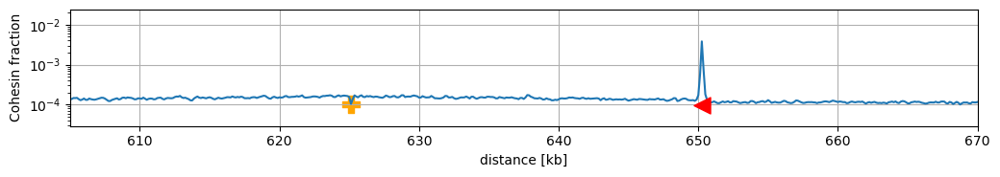

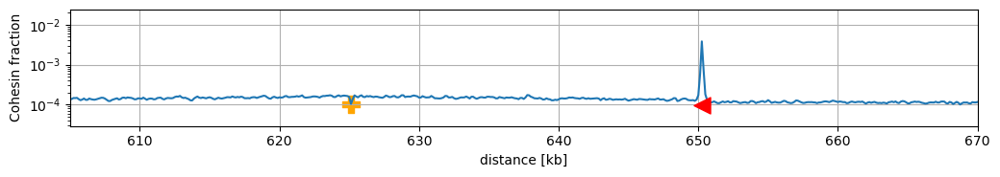

In [5]:
numx,numy = 1,len(path_dict)
rep = 1 
mon = 1000
min_time = 250000
hist_dict = {}
sns.reset_defaults()

names_list = ['folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_50_slife_50_birth_0.05_deltactcf_400_pause_0_sep_100_site_10_monomer_1000_replica_1_steps_200_vel_1',
             'folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_50_slife_50_birth_0.05_deltactcf_1000_pause_0_sep_100_site_10_monomer_1000_replica_1_steps_200_vel_1',
             'folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_50_slife_50_birth_0.0001_deltactcf_400_pause_0_sep_100_site_10_monomer_1000_replica_1_steps_200_vel_1',
             'folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_50_slife_50_birth_0.05_deltactcf_400_pause_0_sep_500_site_10_monomer_1000_replica_1_steps_200_vel_1',
             'folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_50_slife_50_birth_0.05_deltactcf_1000_pause_0_sep_500_site_10_monomer_1000_replica_1_steps_200_vel_1',
             'folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_50_slife_50_birth_0.0001_deltactcf_400_pause_0_sep_500_site_10_monomer_1000_replica_1_steps_200_vel_1']
for name in names_list[:1]:
    print(name)
    params=[ast.literal_eval(i) for i in name.split('folder_')[1].split('_')[1::2]]
    face, back, clife, cof, life, slife, birth, deltactcf, pause, sep, site, mon, rep, step, vel = params

    mapN=mon*site
    lefs = h5py.File(directory+name+'/LEFPositions.h5','r')["positions"]
    lef_lefts = lefs[min_time:,:,0].flatten()
    lef_rights = lefs[min_time:,:,1].flatten()
    print('shape of lefs is '+ str(lefs.shape))
    print('length of loops is %s'%(np.mean(lef_rights-lef_lefts)))
    ctcfrightlist = np.array(h5py.File(directory+name+'/LEFPositions.h5','r')['CTCF_sites_right'])
    ctcfleftlist = np.array(h5py.File(directory+name+'/LEFPositions.h5','r')['CTCF_sites_left'])
    lst = np.array(list(ctcfrightlist))# + list(ctcfleftlist))
    ### list of boundary elements on all replications
    
    lst_t = []
    for i in range(rep):
        lst_t += list(np.array(lst))
    print(lst_t)
    
    
    lef_lefts = lefs[min_time:,:,0].flatten()
    lef_rights = lefs[min_time:,:,1].flatten()
    lef_positions = np.hstack((lef_lefts,lef_rights))

    peak_monomers = peak_positions(lst_t,Window_sizes=np.arange(-Window_size,(Window_size)+1) )
    frip = FRiP(mapN * rep, lef_positions, peak_monomers)
    print(frip)

    plt.figure(figsize = (10.5,1.95))
    a,b = np.histogram(  np.mod( np.hstack((lef_lefts,lef_rights)) , mapN ), np.arange(0,mapN,1))
    plt.scatter(5001*0.125, 0.0001, marker='P', color='orange', s=150)
    plt.plot(np.arange(len(a))*0.125,a/np.sum(a), label=name)
    plt.scatter(ctcfrightlist*0.125,np.zeros(len(ctcfrightlist))+0.000095,marker='<',color='red',s=150,zorder=3)
    plt.scatter(ctcfleftlist*0.125,np.zeros(len(ctcfleftlist))+0.000095,marker='>',color='red',s=150,zorder=3)
    plt.xlim(605, 670)
    plt.grid(True)
    hist_dict[name] = a/np.sum(a)
    plt.ylabel('Cohesin fraction')
    plt.xlabel('distance [kb]')
    plt.yscale('log')
    
    plt.tight_layout()
    #plt.savefig('figs/chip_for_load_%s_delta_%s_sep_%s.pdf'%(birth,deltactcf,sep))
    plt.show()

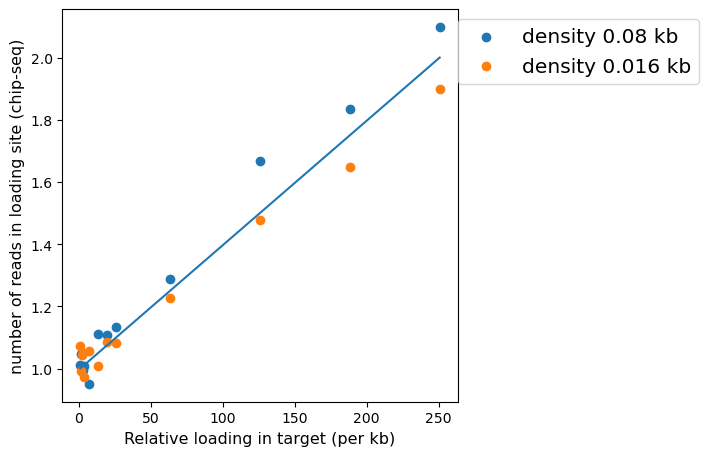

In [9]:
loading_file = pd.read_csv('data/loading.csv')
plt.figure(figsize = (5.1,5.1))
seps = np.unique(loading_file['sep'])
for sep_vals in [100, 500]:
    file = loading_file[loading_file['sep']==sep_vals]
    #print(file)
    birth = file['birth']
    loading_rate = file['laoding']
    plt.scatter(per_k_multiplier(birth),loading_rate, label='density %s kb'%np.round((1/(sep_vals*0.125)),3))
    processivity = 1000
    plt.xlabel('Relative loading in target (per kb)', fontsize=11.5)
    plt.ylabel('number of reads in loading site (chip-seq)', fontsize=11.5)
plt.plot(per_k_multiplier(birth), [(birth_val+processivity)/processivity for birth_val in birth])#, label=r'rough predict ~ $\frac{relative\ load. prob.+processivity}{processivity}$')
plt.legend(loc=(1,0.81),fontsize = 14.5)
plt.show()
                      

### plot relative FRiP

In [25]:
file = pd.read_csv('data/frip_target_respoints_w1_main_tau17_all_density_changing_chn.csv') 
file['birthp']=(file['birth']/0.0001).astype(int)
file['deltactcf']=file['deltactcf']*0.125
new_file =file[file['sep']==74]    
new_file = new_file[new_file['cof']==17.0]
new_file = new_file[new_file['life']==66]
new_file
ref_frip = new_file[(new_file['birthp']==1)&(new_file['deltactcf']==1)]['frip']
ref_frip

,birth,life,deltactcf,clife,cof,sep,face,frip
0,0.0001,50,1000,17.0,1.7,100,1.0,0.011423
1,0.0001,50,1000,17.0,1.7,74,1.0,0.011070
2,0.0001,50,100,17.0,1.7,100,1.0,0.011437
3,0.0001,50,100,17.0,1.7,74,1.0,0.011407
4,0.0001,50,10,17.0,1.7,100,1.0,0.011527
...,...,...,...,...,...,...,...,...
1867,0.1000,66,4,17.0,170.0,74,1.0,0.004334
1868,0.1000,66,5000,17.0,170.0,100,1.0,0.001570
1869,0.1000,66,5000,17.0,170.0,74,1.0,0.001546
1870,0.1000,66,8,17.0,170.0,100,1.0,0.004191


50


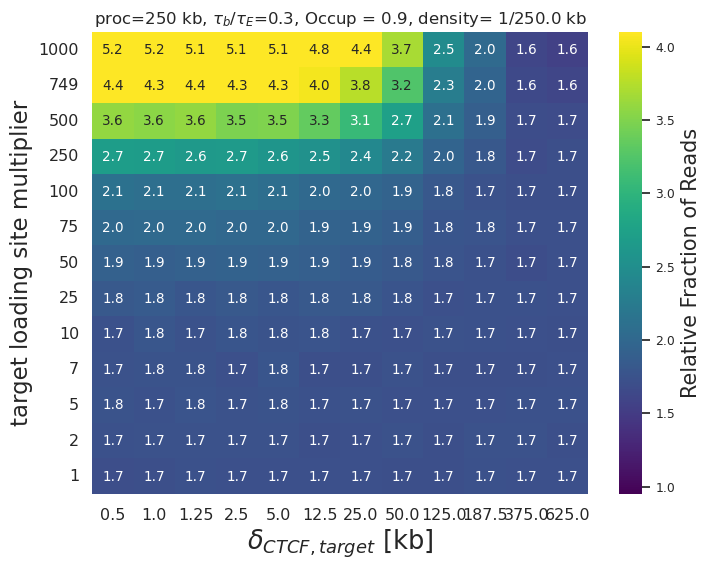

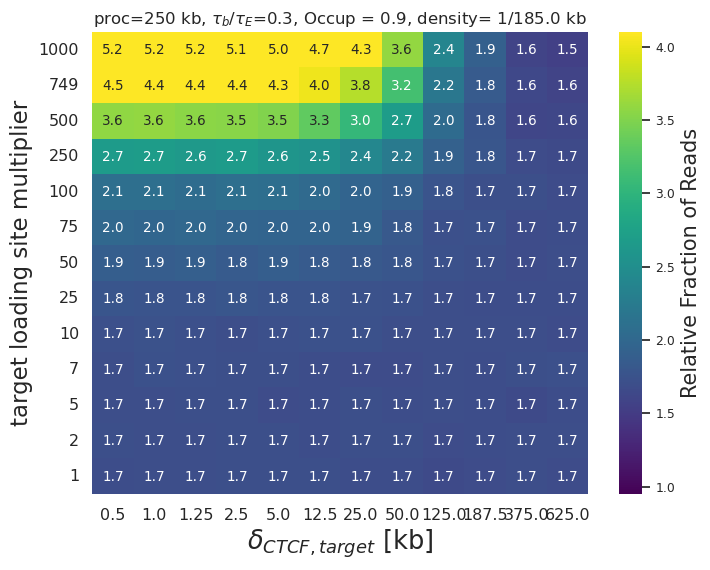

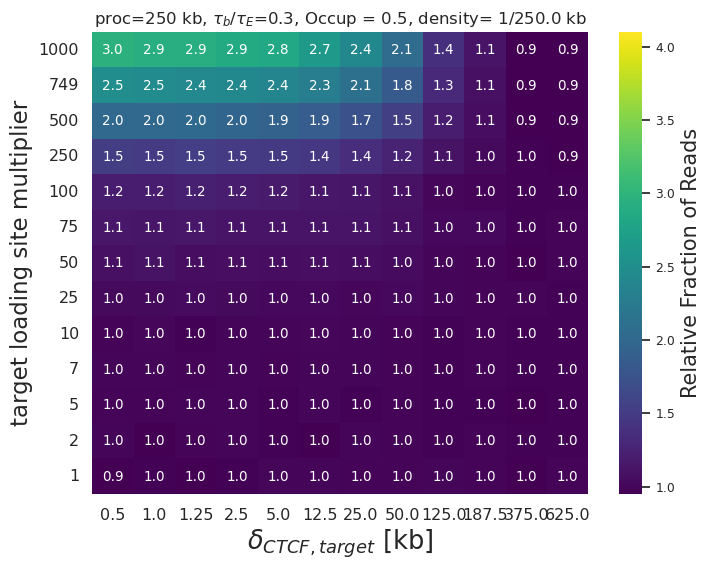

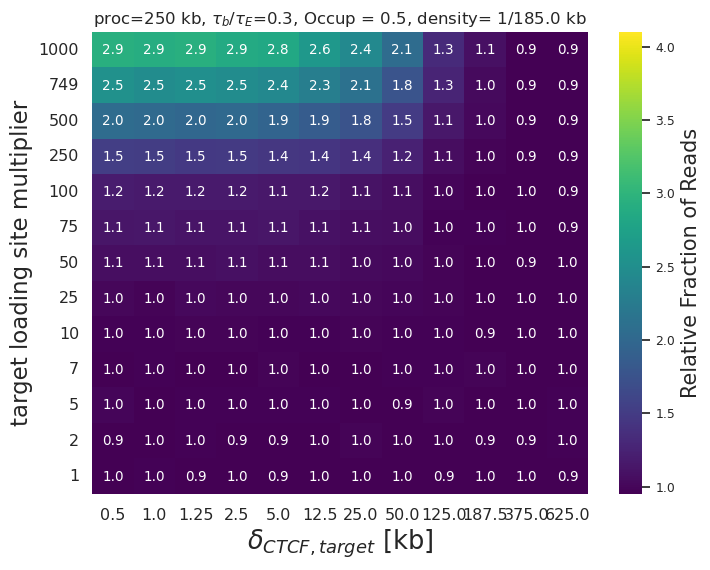

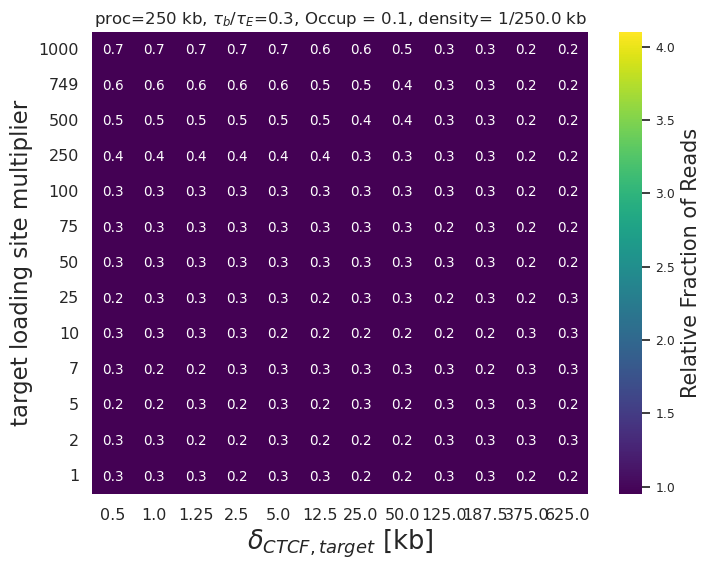

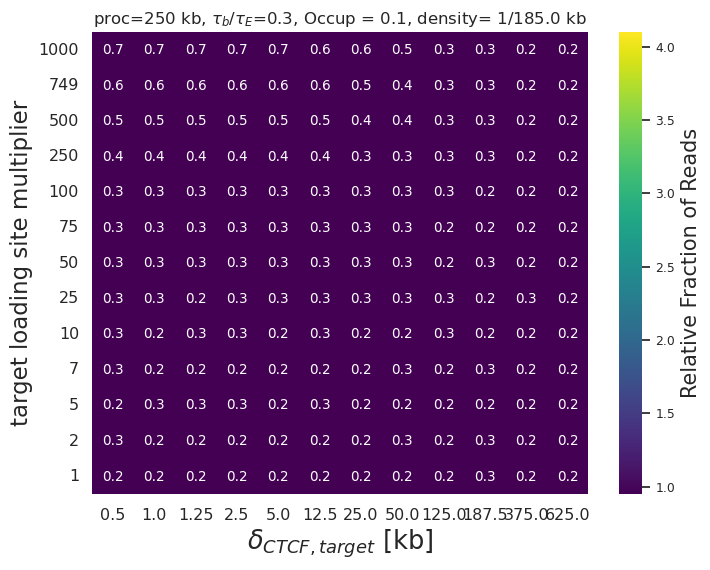

66


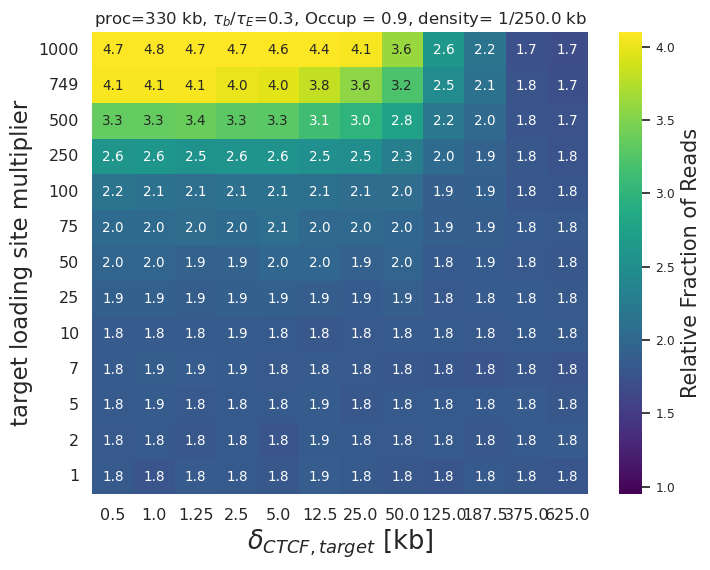

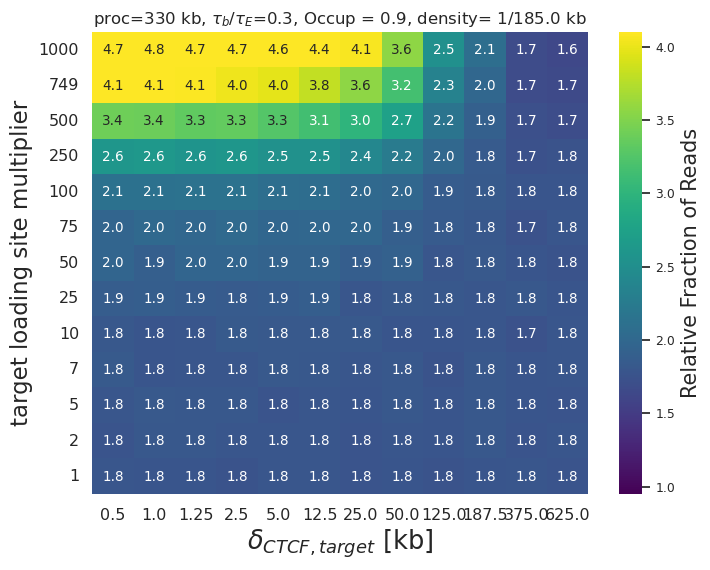

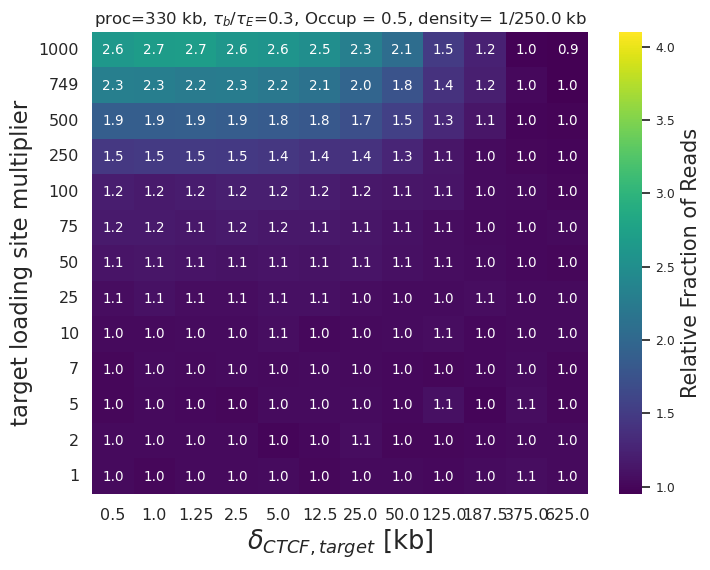

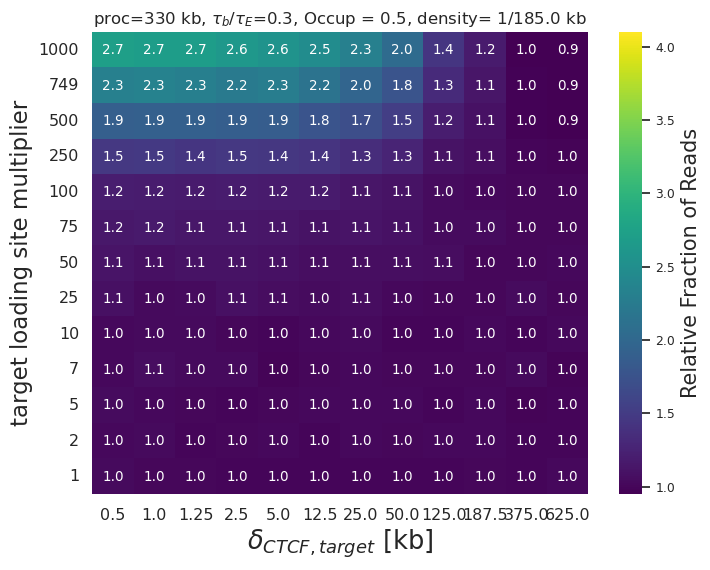

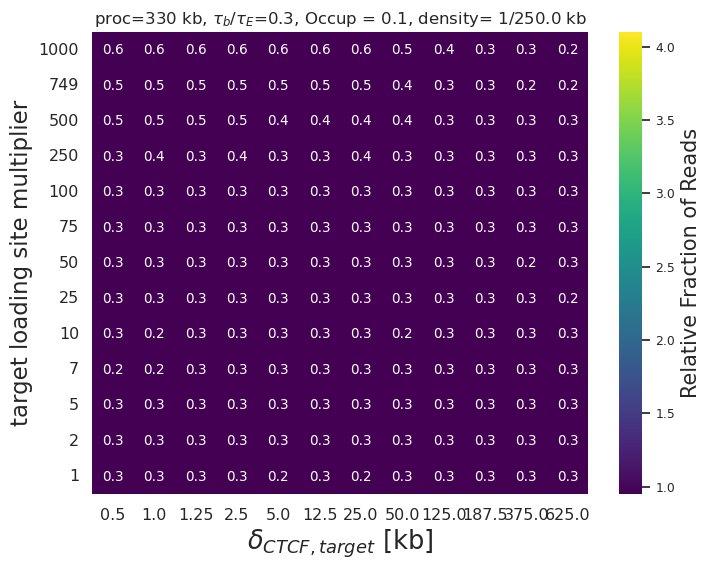

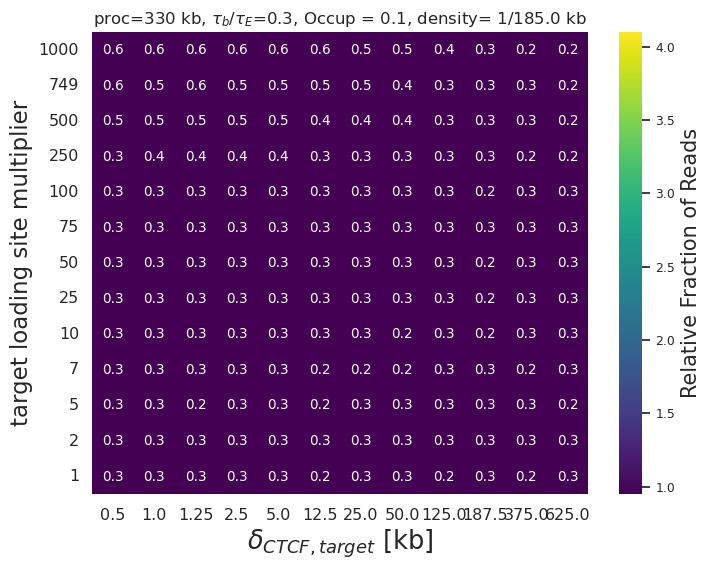

In [34]:
file = pd.read_csv('data/frip_target_respoints_w1_main_tau17_all_density_changing_chn.csv') 

file['birthp']=(file['birth']/0.0001).astype(int)
file['deltactcf']=file['deltactcf']/2*Lattice_site_size # the factor of 2 is because loading site is between two ctcf in deltactcf distance
unique_birth=np.unique(birth)
unique_deltactcf = np.unique(file['deltactcf'])
clife = np.unique(file['clife'])[0]
for life in np.unique(file['life']):
    print(life)
    for cof_val in np.unique(file['cof']):
        for sep_vals in [100, 74]:
            new_file = file[file['life']==life]
            new_file = new_file[new_file['sep']==sep_vals]    
            new_file = new_file[new_file['cof']==cof_val]
            new_file['frip']=(new_file['frip']/float(ref_frip))
            new_file['frip']=new_file['frip'].round(3)
            new_file = new_file[['birthp','deltactcf','frip']]
            
            new_file_filtered = new_file.drop_duplicates(keep = 'first')
            
            dtaframe_grouped = new_file_filtered.groupby(['birthp', 'deltactcf'], as_index=False).mean()
            
            heatmap_data = dtaframe_grouped.pivot('birthp', 'deltactcf', 'frip')
            
            # Create the heatmap using seaborn
            plt.figure(figsize=(8, 6))
            im = sns.heatmap(heatmap_data, annot=True, cmap='viridis', fmt='1.1f',vmin=0.95,vmax=4.1, cbar_kws={'label': 'Frip score'} )
            sns.set(font_scale=0.81)
            cbar = im.collections[0].colorbar
            cbar.set_label('Relative Fraction of Reads', fontsize=15)
            
            # Customize 
            plt.xlabel(r'$\delta_{CTCF, target}$ [kb]', fontsize = 18.5)
            plt.xticks(fontsize =11.5)
            plt.ylabel(r'target loading site multiplier', fontsize =16.5)
            plt.yticks(fontsize=11.5, rotation=0)
            plt.title(r'proc=%s kb, $\tau_b$/$\tau_E$=%s, Occup = %s, density= 1/%s kb'%(life*5, np.round(clife/life,1),np.round(clife/(clife+cof_val),1), sep_vals*2.5), fontsize = 11.95)
            
            plt.gca().invert_yaxis()
            plt.savefig('figs/pdf/fripsweep_for_target_life_%s_clife_%s_cof_%s_sep_%s_normalized_changing_n.pdf'%(life,clife, cof_val, sep_vals), transparent = True, bbox_inches = 'tight')
            plt.show()
    

### normalizing loading rate per kbp 

17.0 1.7 100


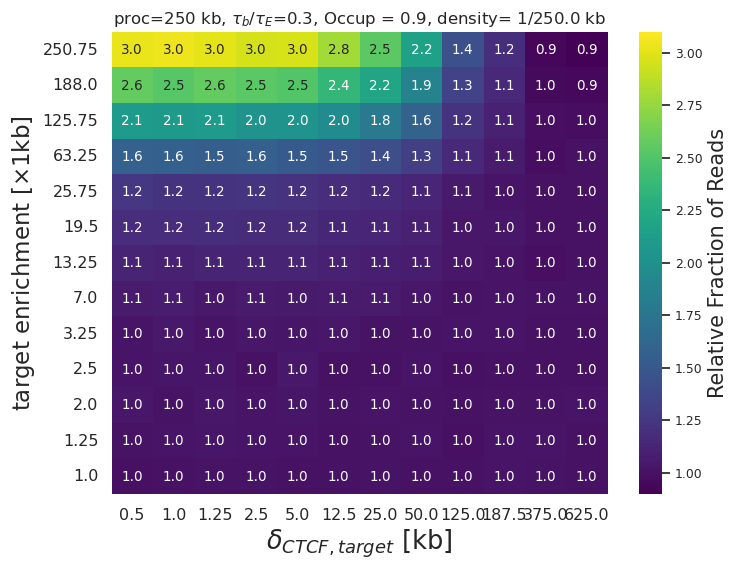

17.0 1.7 74


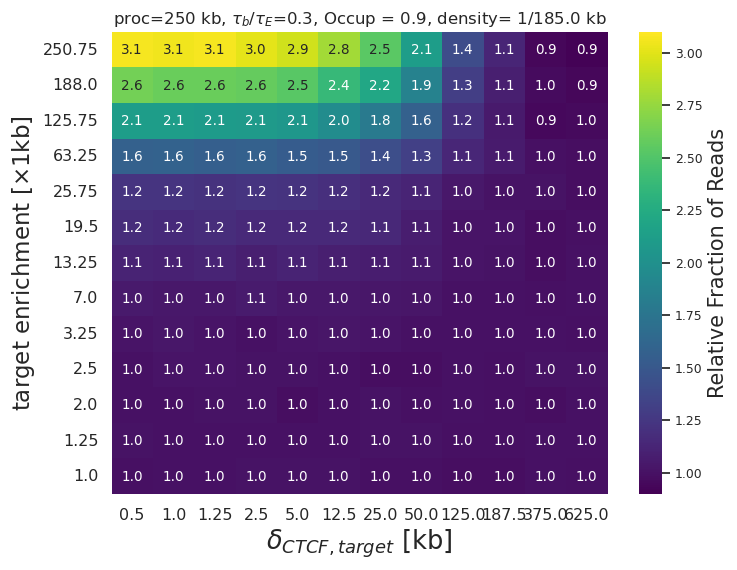

17.0 17.0 100


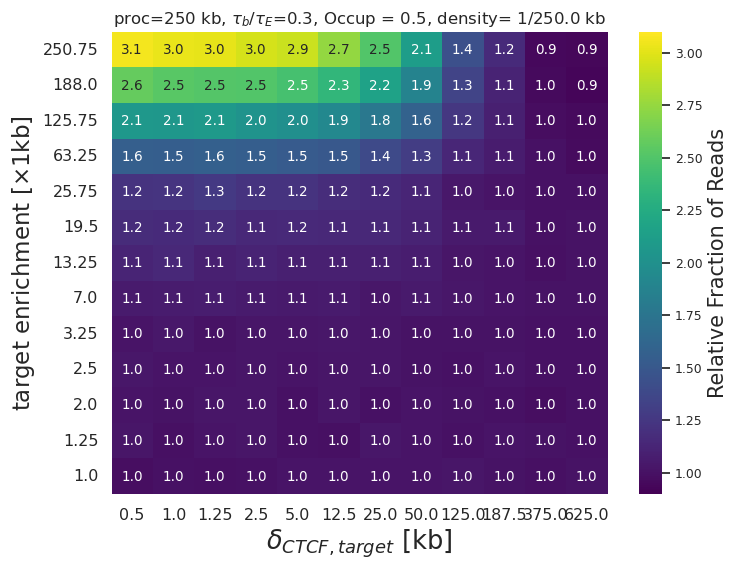

17.0 17.0 74


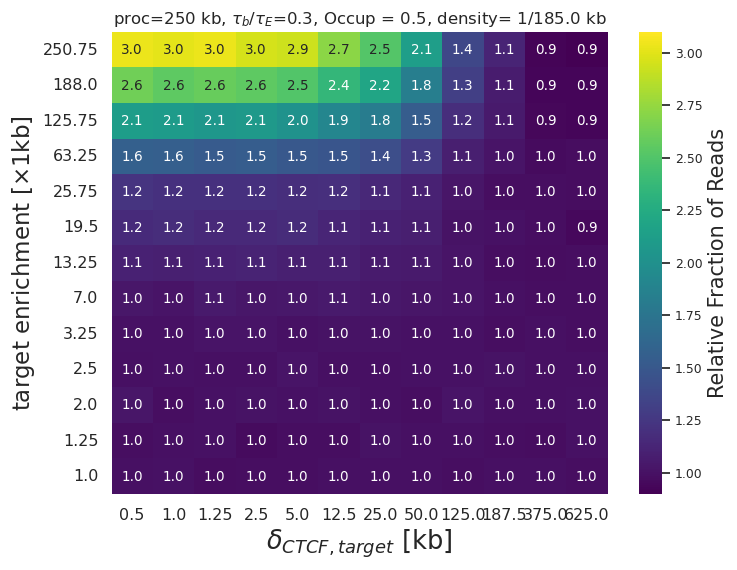

17.0 170.0 100


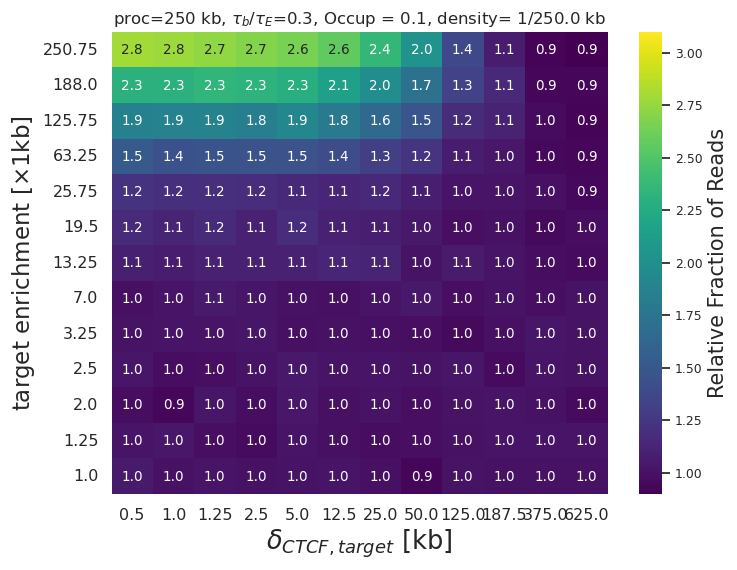

17.0 170.0 74


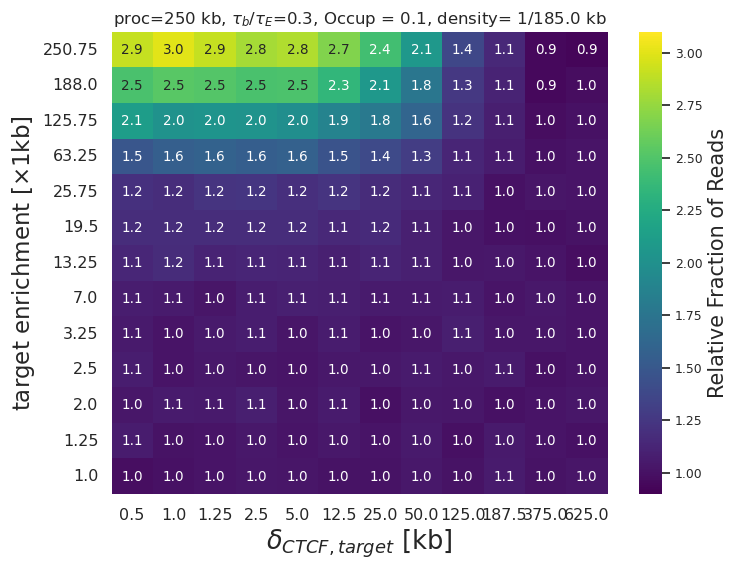

17.0 1.7 100


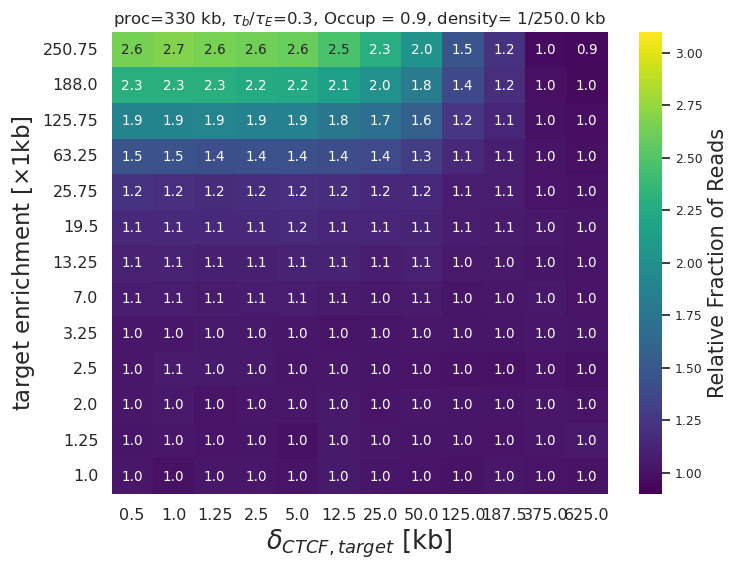

17.0 1.7 74


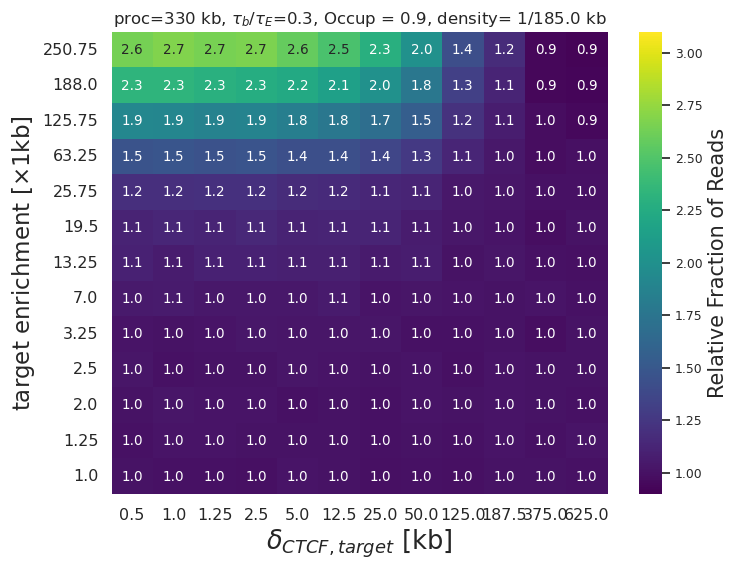

17.0 17.0 100


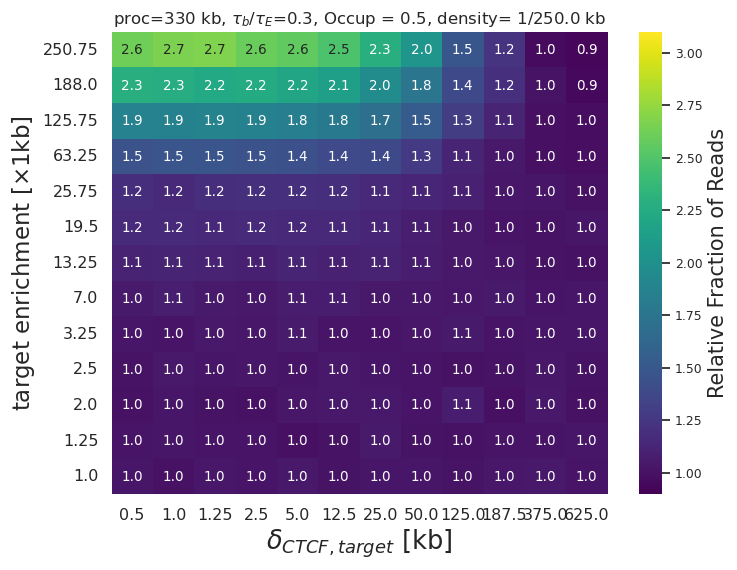

17.0 17.0 74


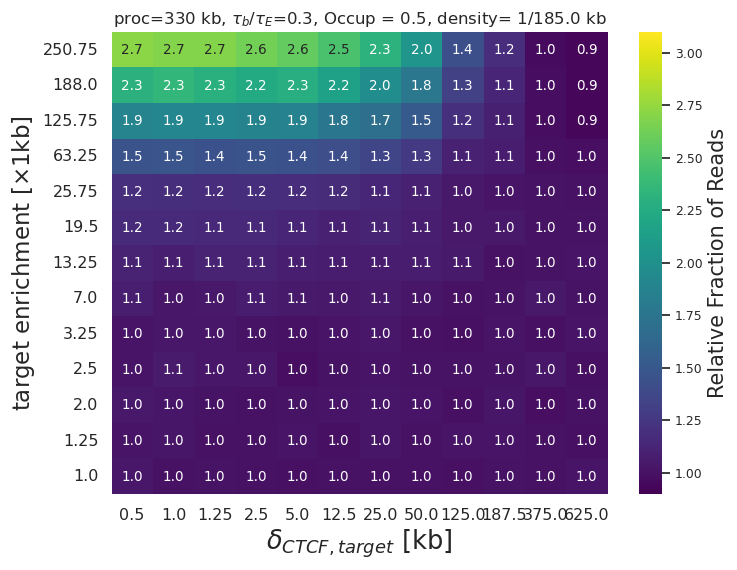

17.0 170.0 100


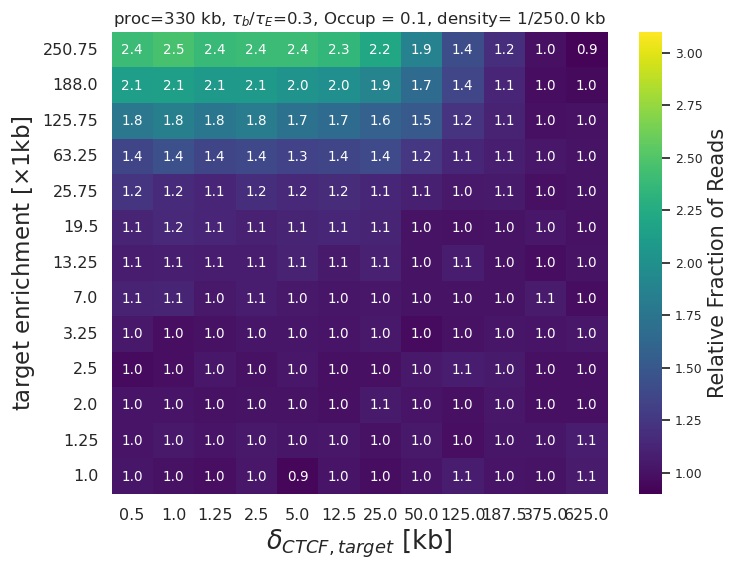

17.0 170.0 74


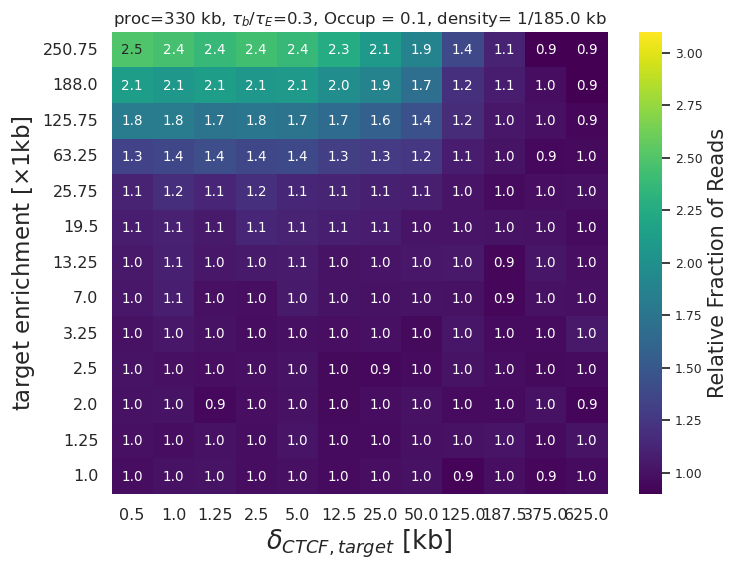

In [54]:
file = pd.read_csv('data/frip_target_respoints_w1_main_tau17_all_density_changing_chn.csv') 

file['birthp']=(file['birth']/0.0001).astype(int)
file['deltactcf']=(file['deltactcf']/2)*Lattice_site_size
unique_birth=np.unique(birth)
file['per_k_mult'] = per_k_multiplier(file['birthp'])
unique_deltactcf = np.unique(file['deltactcf'])
clife = np.unique(file['clife'])[0]
for life in np.unique(file['life']):
    for cof_val in np.unique(file['cof']):
        for sep_vals in [100, 74]:
            print(clife, cof_val,sep_vals)
            new_file = file[file['life']==life]
            new_file = new_file[new_file['sep']==sep_vals]    
            new_file = new_file[new_file['cof']==cof_val]
            ref_frip= new_file.query('per_k_mult==1 & deltactcf == 1')['frip']
            new_file['frip']=(new_file['frip']/float(ref_frip))
            new_file['frip']=new_file['frip'].round(3)
            new_file = new_file[['per_k_mult','deltactcf','frip']]
            
            new_file_filtered = new_file.drop_duplicates(keep = 'first')
            
            dtaframe_grouped = new_file_filtered.groupby(['per_k_mult', 'deltactcf'], as_index=False).mean()
            
            heatmap_data = dtaframe_grouped.pivot('per_k_mult', 'deltactcf', 'frip')
            
            # Create the heatmap using seaborn
            plt.figure(figsize=(8, 6))
            im = sns.heatmap(heatmap_data, annot=True, cmap='viridis', fmt='1.1f',vmin=0.9,vmax=3.1, cbar_kws={'label': 'Frip score'} )
            sns.set(font_scale=0.81)
            cbar = im.collections[0].colorbar
            cbar.set_label('Relative Fraction of Reads', fontsize=15)
            
            # Customize 
            plt.xlabel(r'$\delta_{CTCF, target}$ [kb]', fontsize = 18.5)
            plt.xticks(fontsize =11.5)
            plt.ylabel(r'target enrichment [$\times$1kb]', fontsize =16.5)
            plt.yticks(fontsize=11.5, rotation=0)
            plt.title(r'proc=%s kb, $\tau_b$/$\tau_E$=%s, Occup = %s, density= 1/%s kb'%(life*5, np.round(clife/life,1),np.round(clife/(clife+cof_val),1), sep_vals*2.5), fontsize = 11.95)
            
            plt.gca().invert_yaxis()
            plt.savefig('figs/pdf/fripsweep_for_target_life_%s_clife_%s_cof_%s_sep_%s_normalized_changing_n_per_k.png'%(life,clife, cof_val, sep_vals), transparent = True, bbox_inches = 'tight')
            plt.show()
    

50
17.0 1.7 100


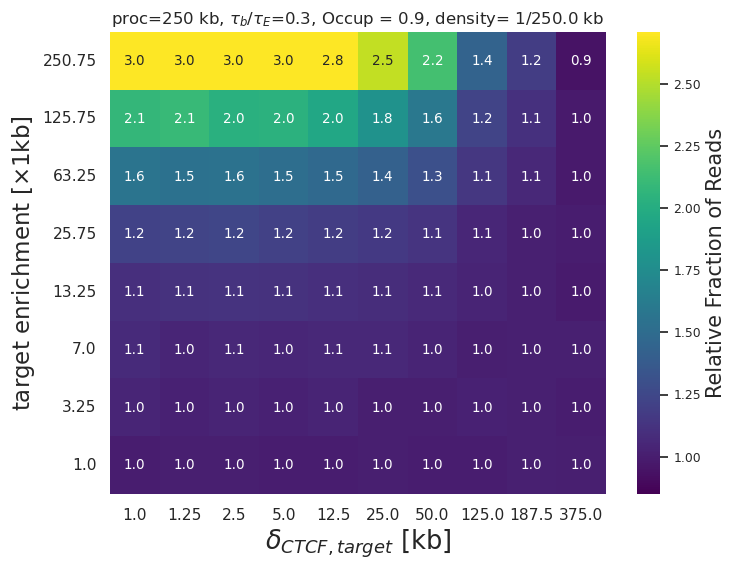

17.0 1.7 74


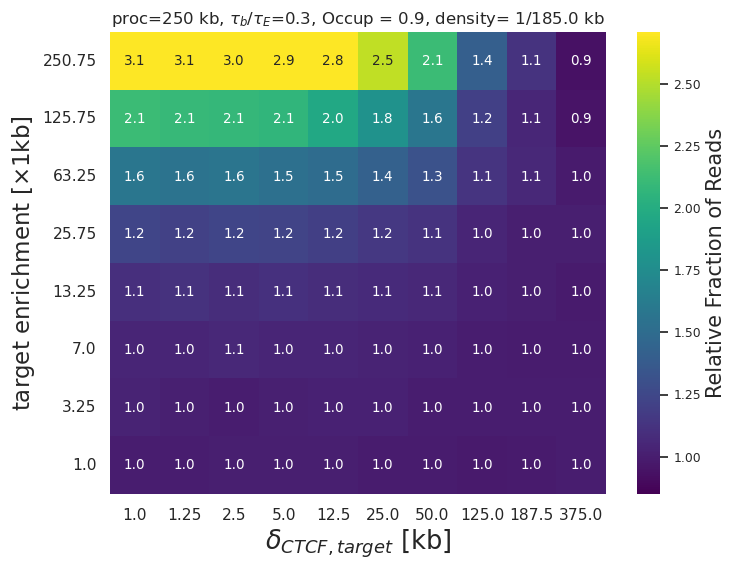

17.0 17.0 100


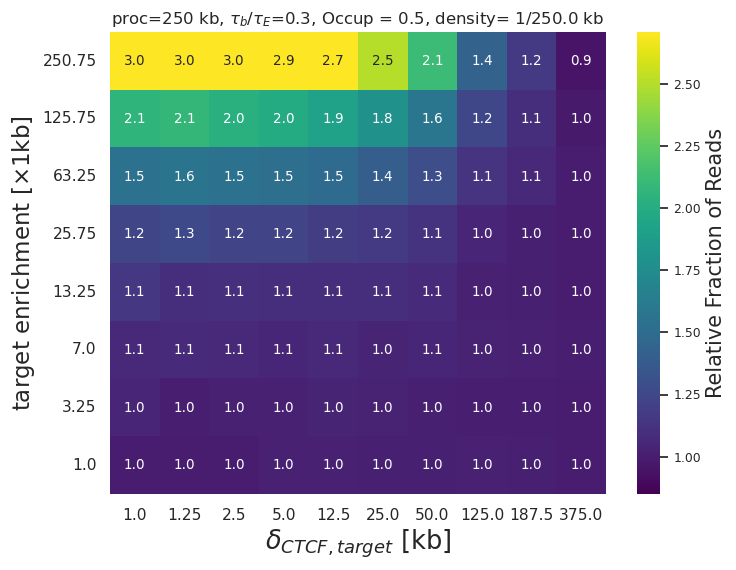

17.0 17.0 74


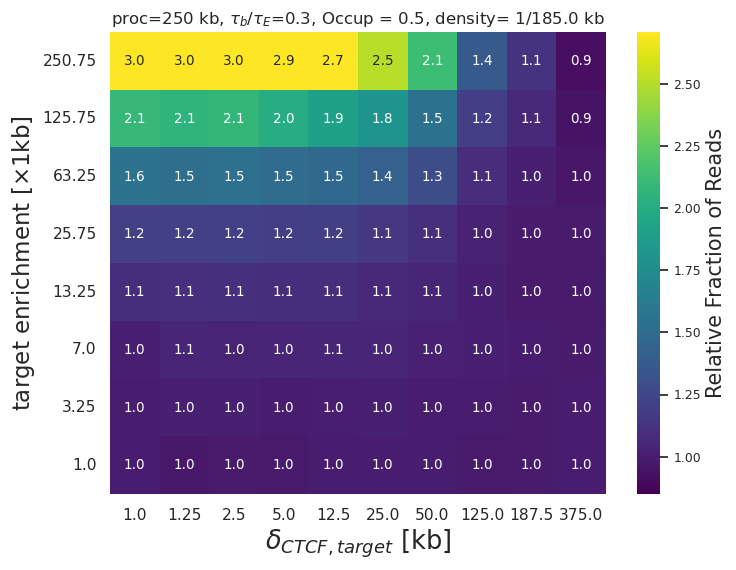

17.0 170.0 100


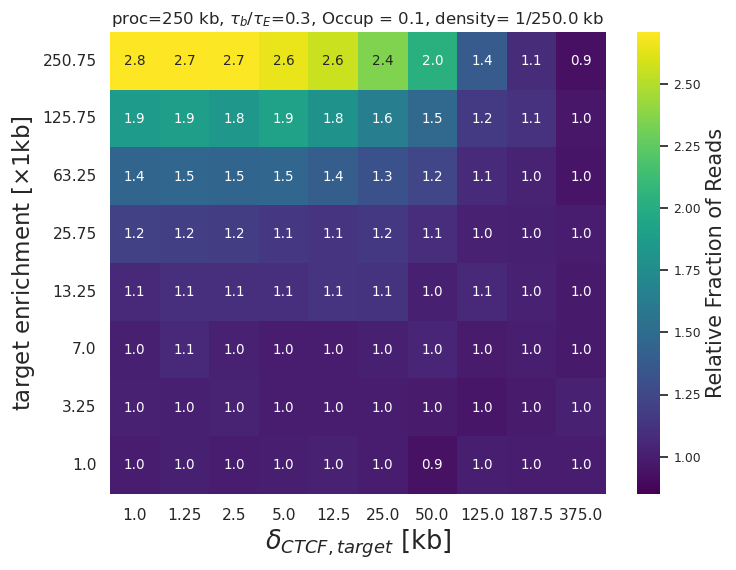

17.0 170.0 74


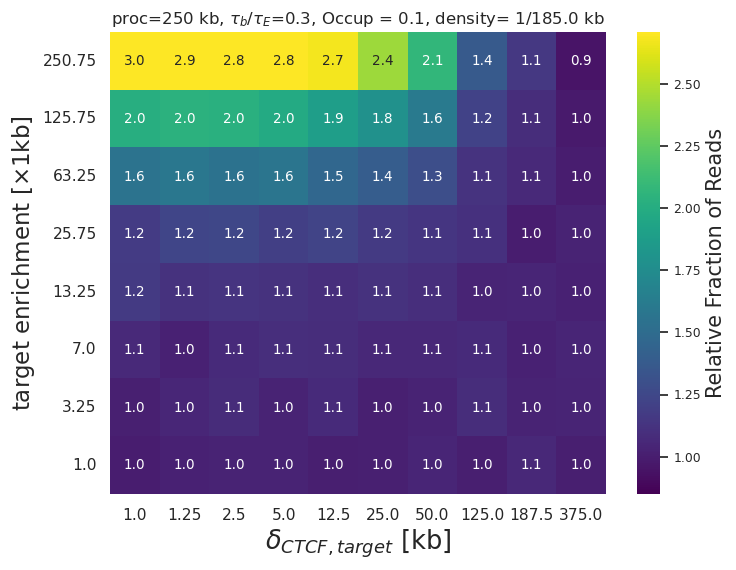

66
17.0 1.7 100


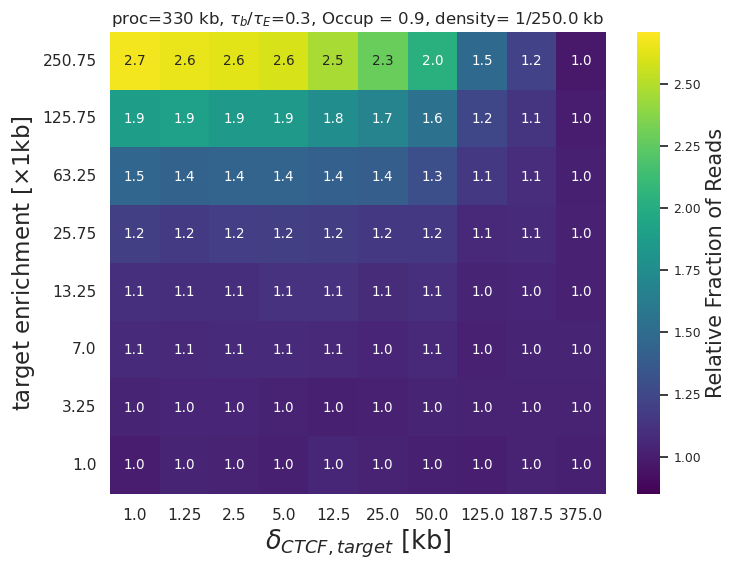

17.0 1.7 74


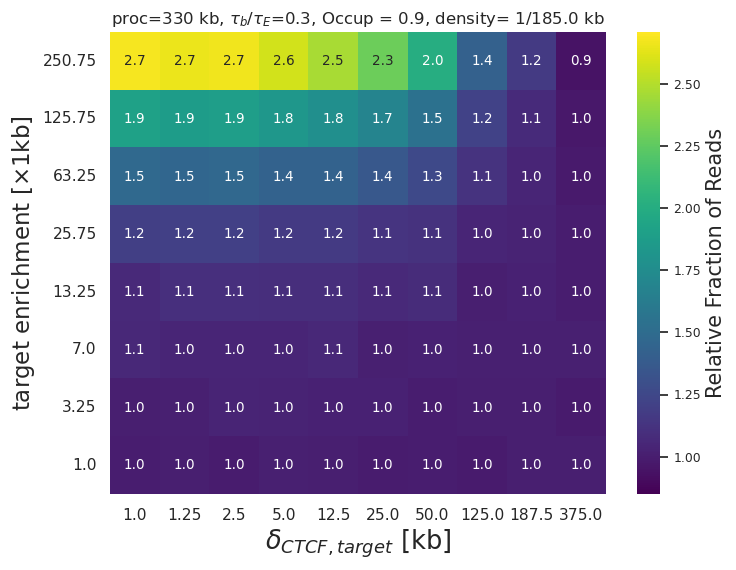

17.0 17.0 100


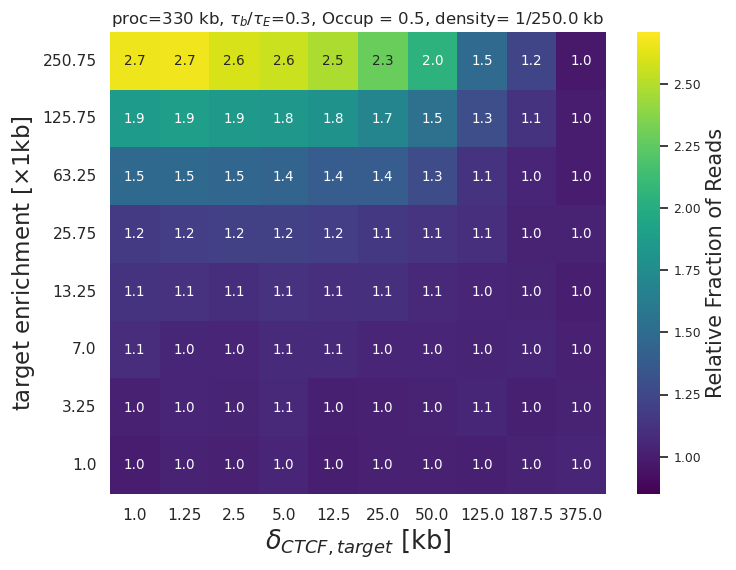

17.0 17.0 74


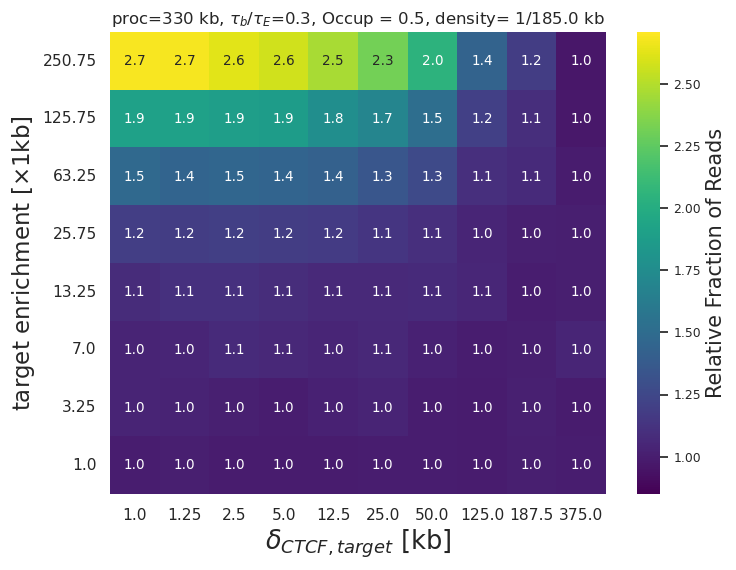

17.0 170.0 100


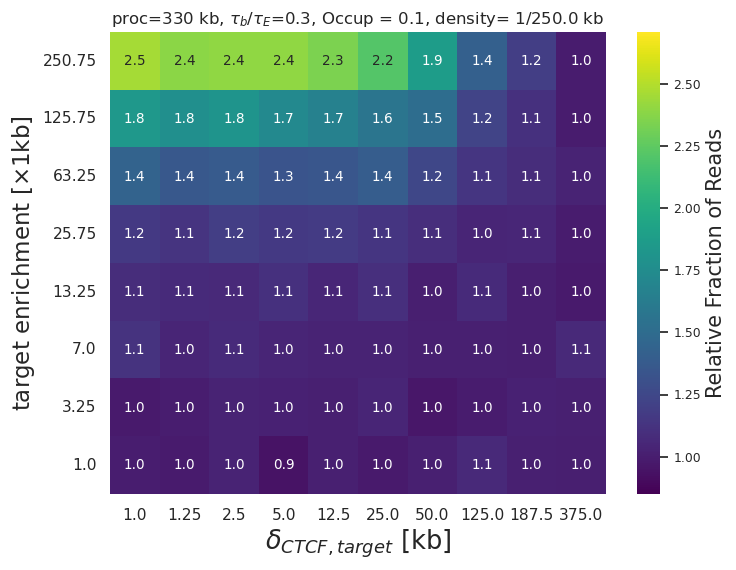

17.0 170.0 74


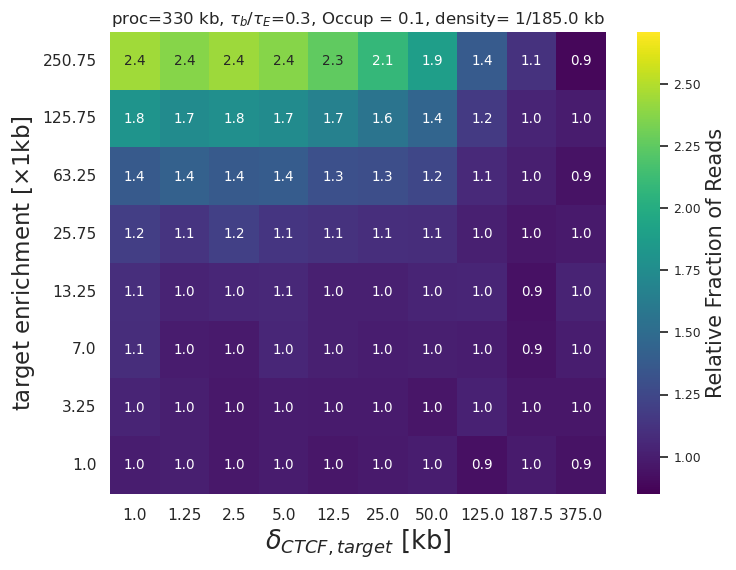

In [57]:
file = pd.read_csv('data/frip_target_respoints_w1_main_tau17_all_density_changing_chn.csv') 

file['birthp']=(file['birth']/0.0001).astype(int)
file['deltactcf']=file['deltactcf']*0.125
unique_birth=np.unique(birth)
file['per_k_mult'] = per_k_multiplier(file['birthp'])
target_zone = [1, 3.25, 7.0,  13.25, 25.75, 63.25, 125.75, 250, 1250, 250.75]
file = file[file['per_k_mult'].isin(target_zone)]
unique_deltactcf = np.unique(file['deltactcf'])
clife = np.unique(file['clife'])[0]
file = file.query('deltactcf>=0.9 and deltactcf<=500')
for life in np.unique(file['life']):
    print(life)
    for cof_val in np.unique(file['cof']):
        for sep_vals in [100, 74]:
            print(clife, cof_val,sep_vals)
            new_file = file[file['life']==life]
            new_file = new_file[new_file['sep']==sep_vals]    
            #print(new_file)
            new_file = new_file[new_file['cof']==cof_val]
            #ref_frip = new_file[(new_file['birthp']==1)&(new_file['deltactcf']==1)]['frip']
            ref_frip= new_file.query('per_k_mult==1 & deltactcf == 1')['frip']
            new_file['frip']=(new_file['frip']/float(ref_frip))
            new_file['frip']=new_file['frip'].round(3)
            new_file = new_file[['per_k_mult','deltactcf','frip']]
            
            new_file_filtered = new_file.drop_duplicates(keep = 'first')
            
            dtaframe_grouped = new_file_filtered.groupby(['per_k_mult', 'deltactcf'], as_index=False).mean()
            
            heatmap_data = dtaframe_grouped.pivot('per_k_mult', 'deltactcf', 'frip')
            
            # Create the heatmap using seaborn
            plt.figure(figsize=(8, 6))
            im = sns.heatmap(heatmap_data, annot=True, cmap='viridis', fmt='1.1f',vmin=0.85,vmax=2.71, cbar_kws={'label': 'Frip score'} )
            sns.set(font_scale=0.81)
            cbar = im.collections[0].colorbar
            cbar.set_label('Relative Fraction of Reads', fontsize=15)
            
            # Customize 
            plt.xlabel(r'$\delta_{CTCF, target}$ [kb]', fontsize = 18.5)
            plt.xticks(fontsize =11.15)
            plt.ylabel(r'target enrichment [$\times$1kb]', fontsize =16.5)
            plt.yticks(fontsize=11.15, rotation=0)
            plt.title(r'proc=%s kb, $\tau_b$/$\tau_E$=%s, Occup = %s, density= 1/%s kb'%(life*5, np.round(clife/life,1),np.round(clife/(clife+cof_val),1), sep_vals*2.5), fontsize = 11.95)
            
            plt.gca().invert_yaxis()
            plt.savefig('figs/pdf/fripsweep_for_target_life_%s_clife_%s_cof_%s_sep_%s_normalized_changing_n_per_k.pdf'%(life,clife, cof_val, sep_vals), transparent = True, bbox_inches = 'tight')
            plt.show()
    

### creating md maps

In [58]:
path_dict = {}

directory = '/scratch1/rahmanin/target_loading_cohesin/target/sims_rev_md/'

for name  in glob.glob(directory+'/folder_*'):
    path_dict[name.split('/sims_rev_md/')[1][:]]= name
path_dict = dict(sorted(path_dict.items()))
print(len(path_dict))

174


In [46]:
monomer_per_replica = 1000

mapN = 1 * monomer_per_replica #number of monomer to 
total_monomers = 1000
mapstarts = (np.arange(0,1000 , monomer_per_replica))
min_time = 0
max_time = 3000
skip_freq = 5
refresh = True
if refresh== True:
    map_dict_eq = {}
i=1
listi = ['folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1']
for name in list(path_dict)[:1]:
    params=[ast.literal_eval(i) for i in name.split('folder_')[1].split('_')[1::2]]
    face, back, clife, cof, life, slife, birth, deltactcf, pause, sep, site, mon, rep, step, vel = params
    if life ==66 and sep==74:
        print(name)
        URIs = polychrom.hdf5_format.list_URIs(path_dict[name])
        URIs_eq = np.array(URIs)[(np.array([int(i.split("::")[-1]) for i in URIs]) > min_time)&(np.array([int(i.split("::")[-1]) for i in URIs]) < max_time)][::skip_freq]
        #URIs_eq = np.array(URIs)[(np.array([int(i.split("::")[-1]) for i in URIs]) > min_time)][::skip_freq]
        mrc = polychrom.contactmaps.monomerResolutionContactMapSubchains(
            URIs_eq,
            mapstarts,
            mapN,
            cutoff=2.3, n=8)
        map_dict_eq[name] = mrc
        np.savez_compressed('./maps/%s.npz' % (name), mrc)
        mrc  = mrc.astype(float)
        mrc /= np.median(np.diag(mrc,2))
        mat = np.log10(mrc)
        vmax = np.median(np.diag(mat,2))
        vmin = vmax - 3
        im=plt.matshow(mat[:,:], cmap='fall',fignum=False);
        cbar=plt.colorbar(im,label='Contact frequency [log]')
        cbar.set_label(label='Contact frequency [log]',fontsize=11.95)
        cbar.ax.tick_params(labelsize=10.5)
        #cbar.set_label(r'$\zeta\ [s^{-1}]$', fontsize=16)
        plt.xticks([0,100,200,300,400,500, 600, 700, 800, 900, 1000],fontsize=8.1)
        plt.yticks([0,100,200,300,400,500],fontsize=8.1)
        plt.title('relative load prob %s'%500)
        plt.gca().set_xticklabels(['0kb', '25kb', '50kb','75kb','100kb', '125kb', '150kb', '175kb', '200kb', '225kb', '250kb'])
        #plt.gca().set_yticklabels(['0Mb', '0.25Mb', '0.5Mb','0.75Mb','1Mb', '1.25Mb'])#plt.gca().set_yticklabels([])
        plt.gca().set_yticklabels([])
        plt.title('relative load prob %s'%(birth/0.0001))
        plt.savefig('./figs/maps/maps_for_%s.png'%name,transparent=True)
        
        plt.show()
    

In [59]:
sns.reset_defaults()

An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()


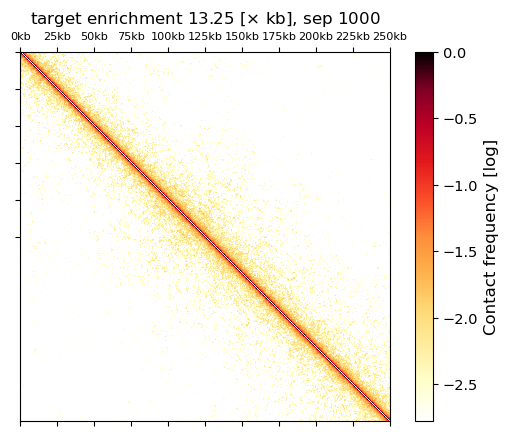

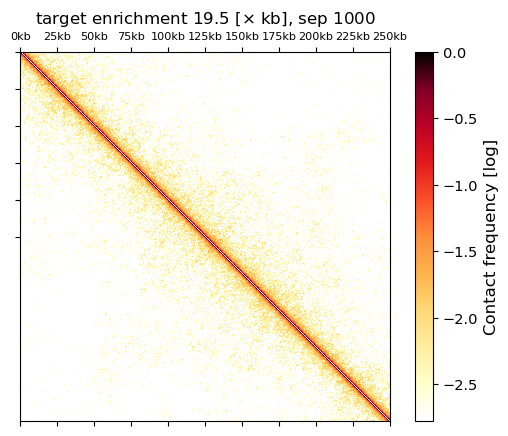

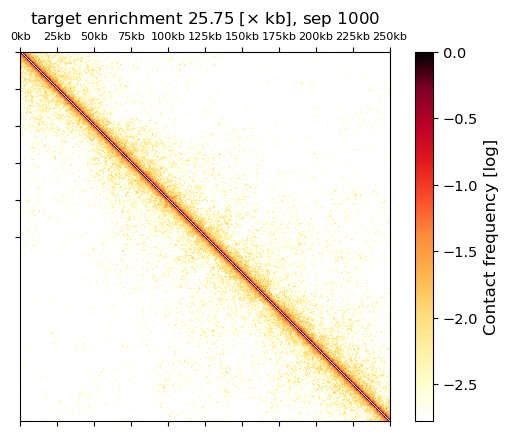

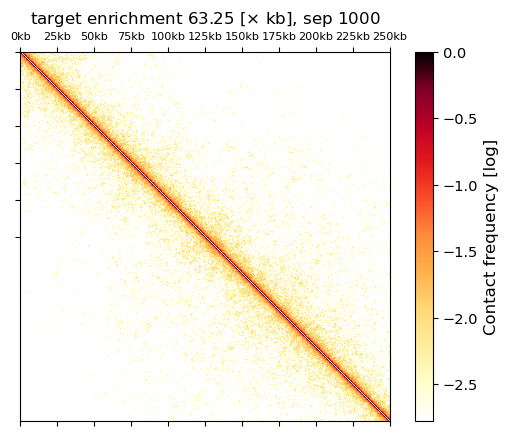

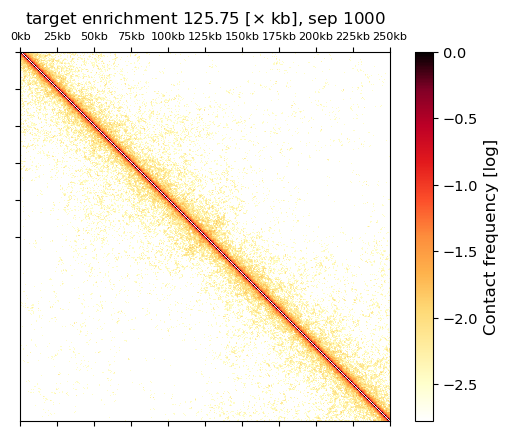

An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred


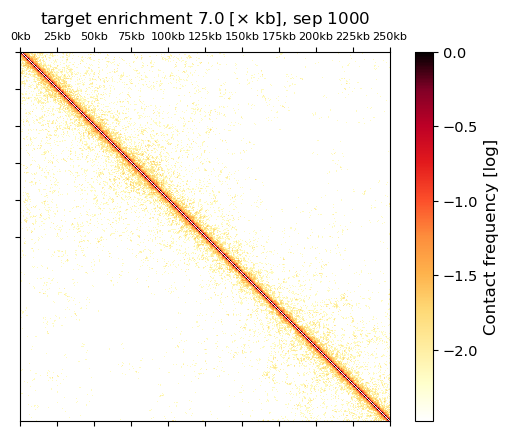

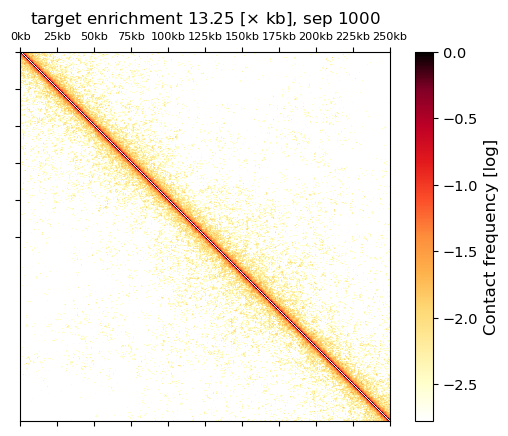

An error occurred
An error occurred


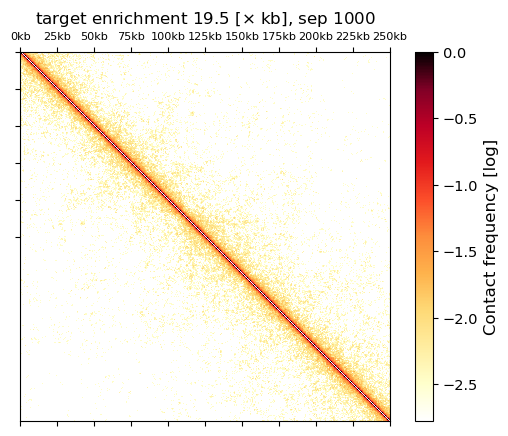

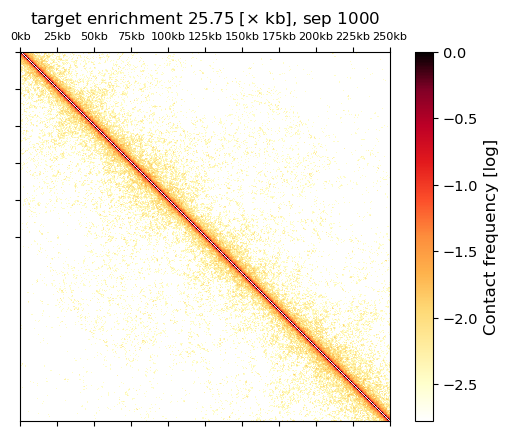

An error occurred
An error occurred


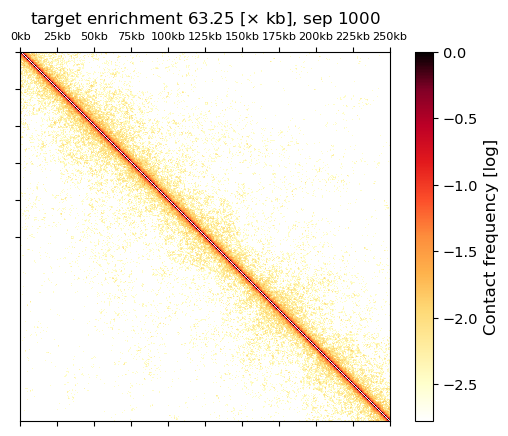

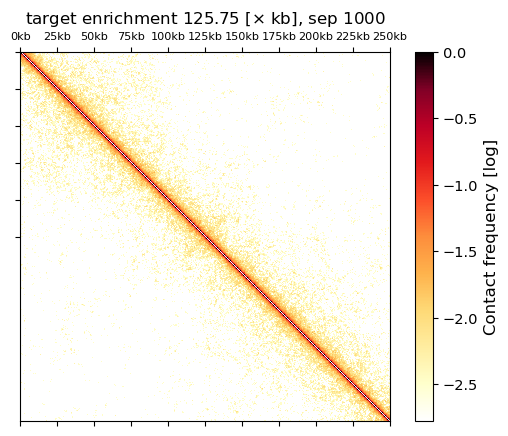

An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred
An error occurred


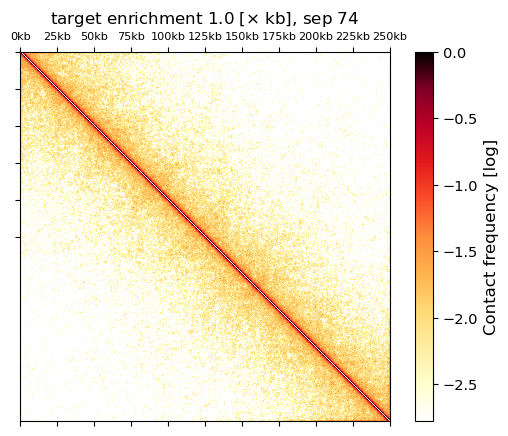

An error occurred


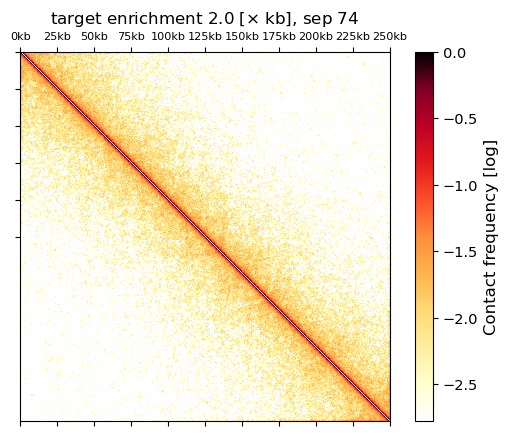

An error occurred


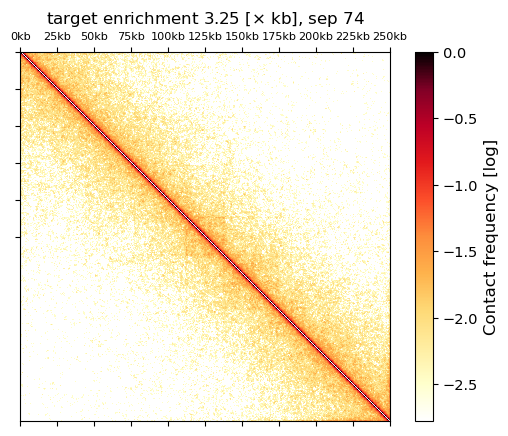

An error occurred


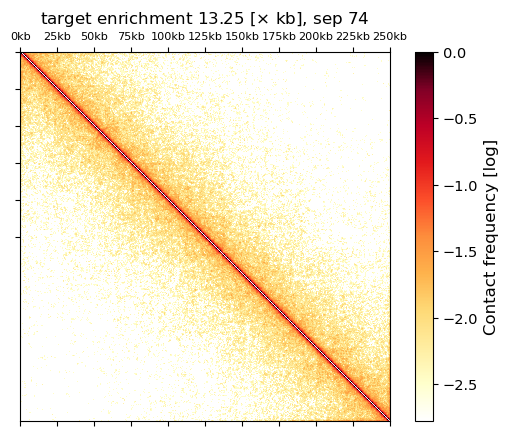

An error occurred


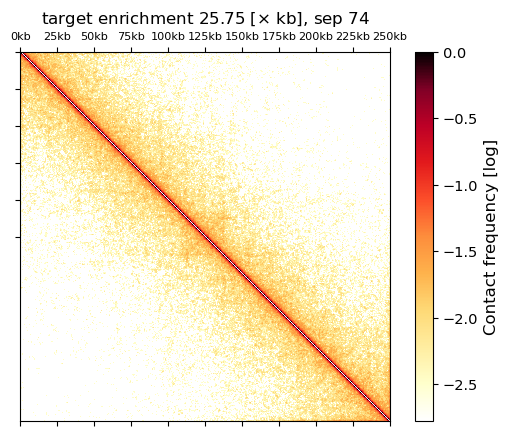

An error occurred


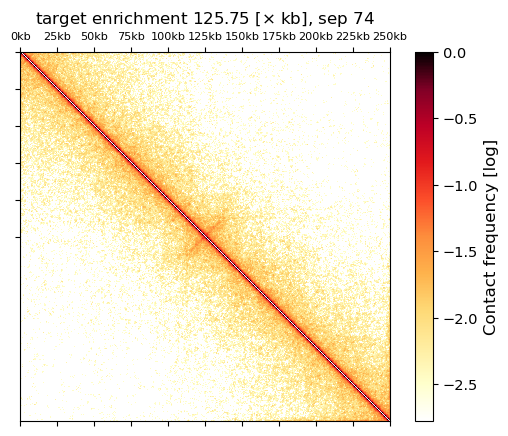

An error occurred


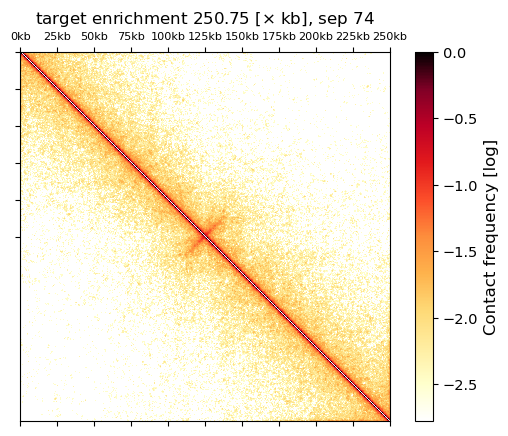

An error occurred


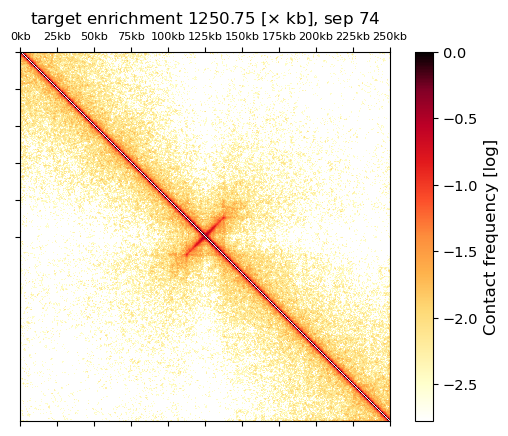

In [60]:
for name in list(path_dict)[:]:

    params=[ast.literal_eval(i) for i in name.split('folder_')[1].split('_')[1::2]]
    face, back, clife, cof, life, slife, birth, deltactcf, pause, sep, site, mon, rep, step, vel = params
    if deltactcf==1000:
        try:
            data=np.load('./maps/%s.npz' % name)
            mrc=data['arr_0']
            mrc  = mrc.astype(float)
            mrc /= np.median(np.diag(mrc,2))
            mat = np.log10(mrc)
            vmax = np.median(np.diag(mat,2))
            vmin = vmax - 3
            im=plt.matshow(mat[:,:], cmap='fall',fignum=False);
            cbar=plt.colorbar(im,label='Contact frequency [log]')
            cbar.set_label(label='Contact frequency [log]',fontsize=11.95)
            cbar.ax.tick_params(labelsize=10.5)
            plt.xticks([0,100,200,300,400,500, 600, 700, 800, 900, 1000],fontsize=8.1)
            plt.yticks([0,100,200,300,400,500],fontsize=8.1)
            plt.title('relative load prob %s'%500)
            plt.gca().set_xticklabels(['0kb', '25kb', '50kb','75kb','100kb', '125kb', '150kb', '175kb', '200kb', '225kb', '250kb'])
            #plt.gca().set_yticklabels(['0Mb', '0.25Mb', '0.5Mb','0.75Mb','1Mb', '1.25Mb'])#plt.gca().set_yticklabels([])
            plt.gca().set_yticklabels([])
            plt.title(r'target enrichment %s [$\times$ kb], sep %s'%(per_k_multiplier(birth/0.0001), sep))
            plt.savefig('./figs/maps/maps_for_%s.png'%name,transparent=True)
            plt.show() 
        except Exception as e:
            print(f"An error occurred")

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0001_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


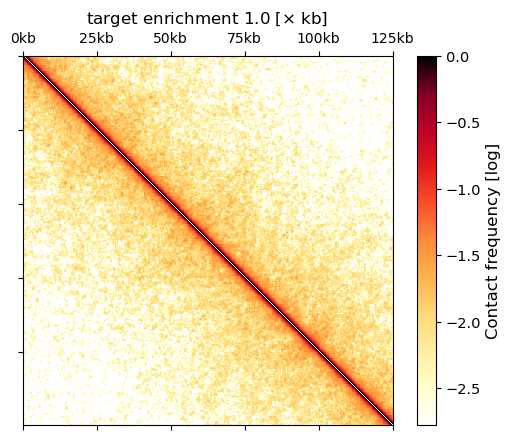

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0001_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


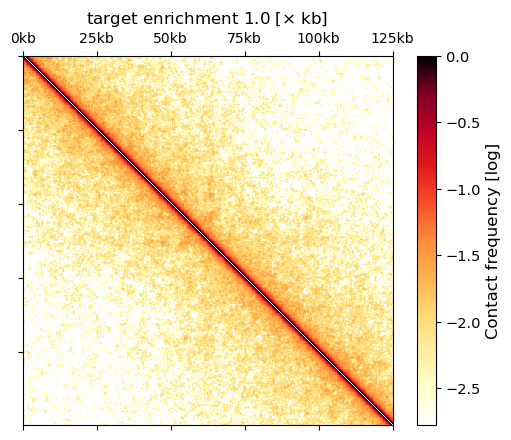

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0001_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


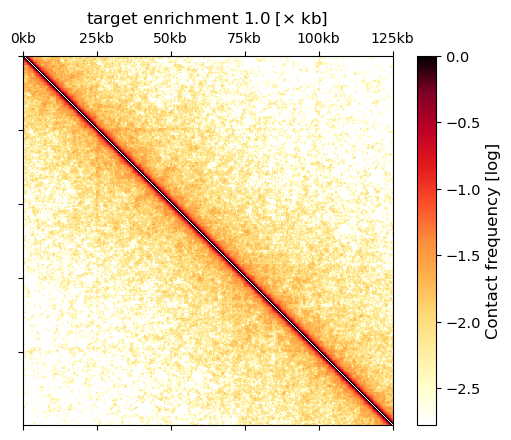

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0005_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


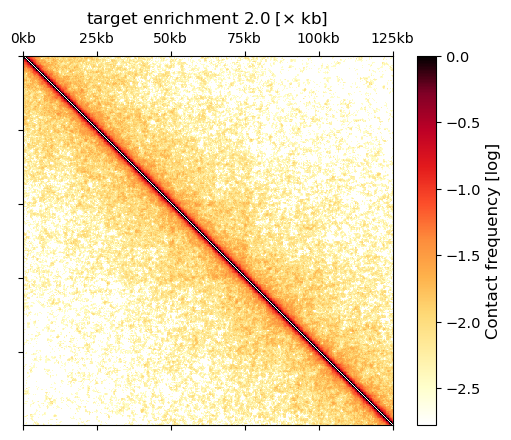

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0005_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


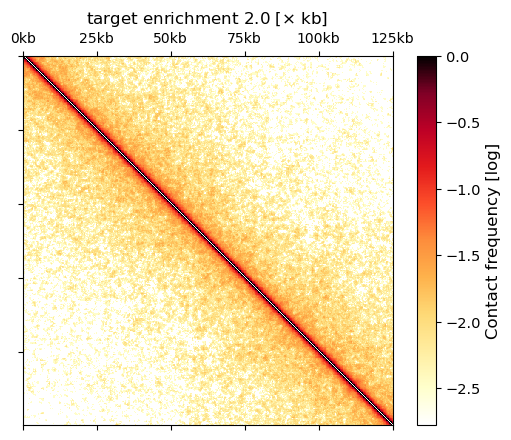

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0005_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


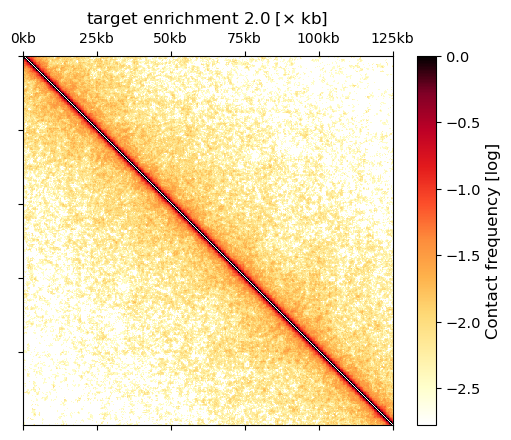

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.001_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


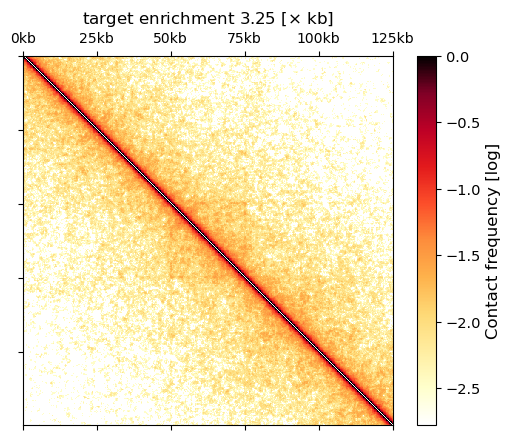

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.001_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


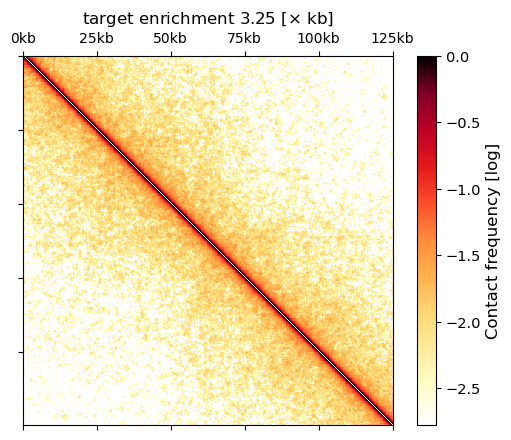

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.001_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


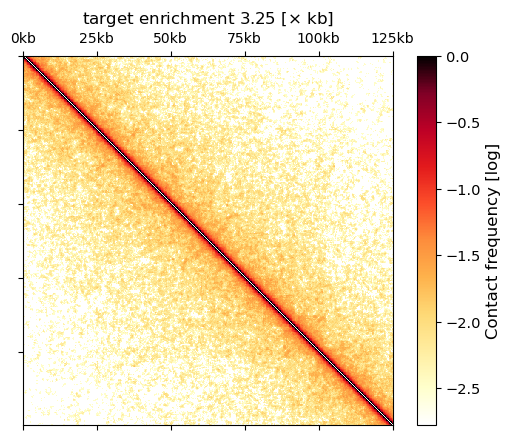

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.005_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


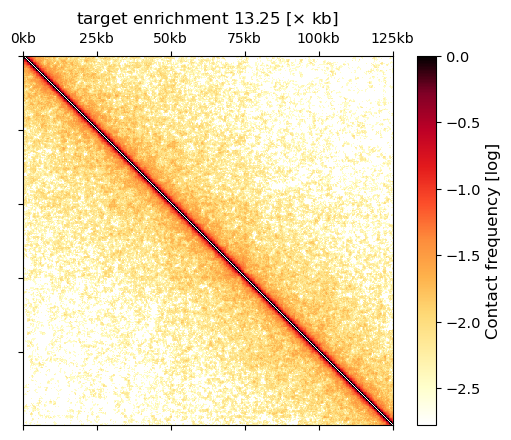

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.005_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


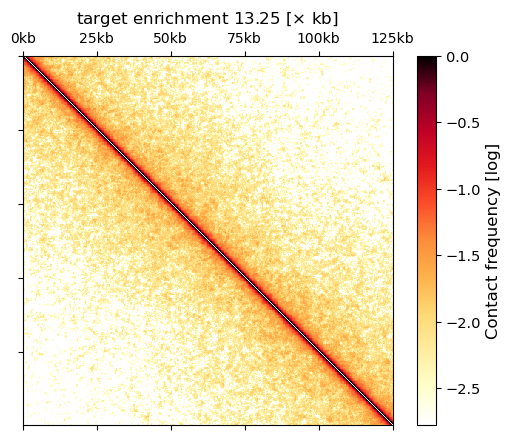

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.005_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


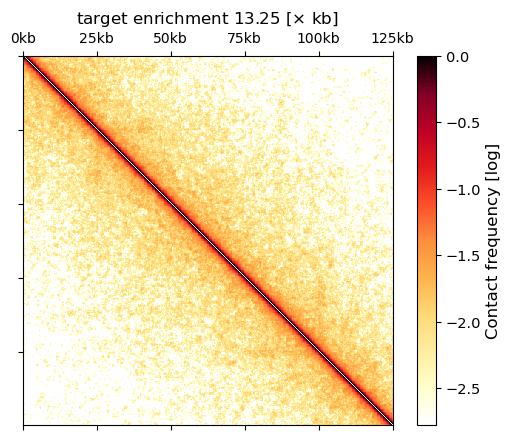

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.01_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


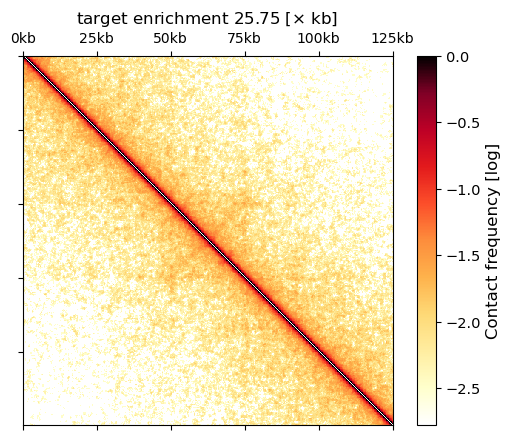

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.01_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


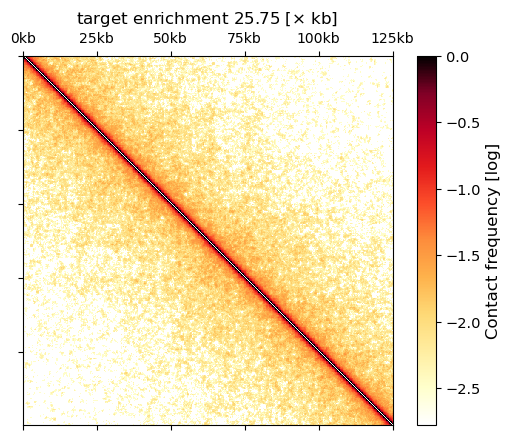

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.01_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


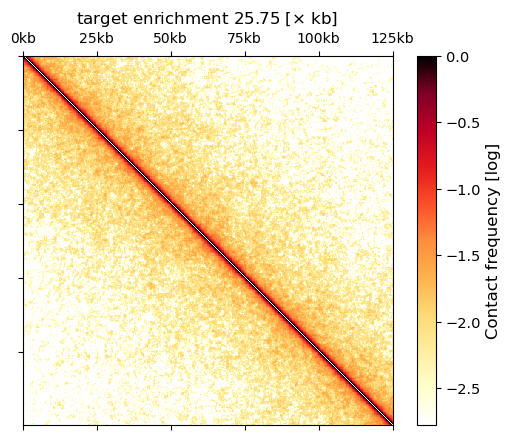

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.05_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


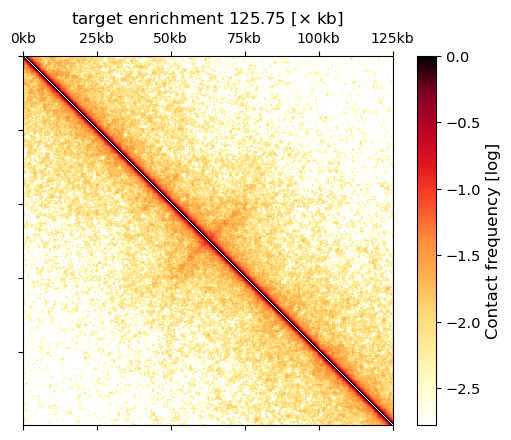

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.05_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


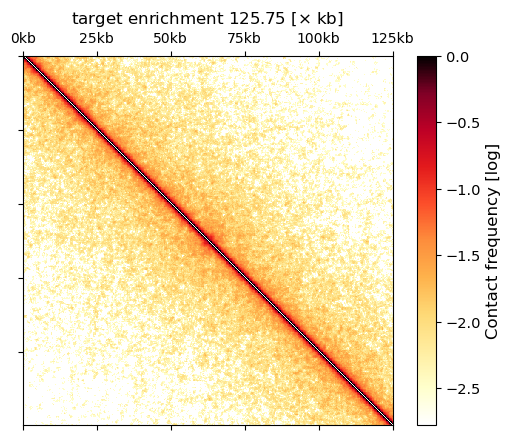

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.05_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


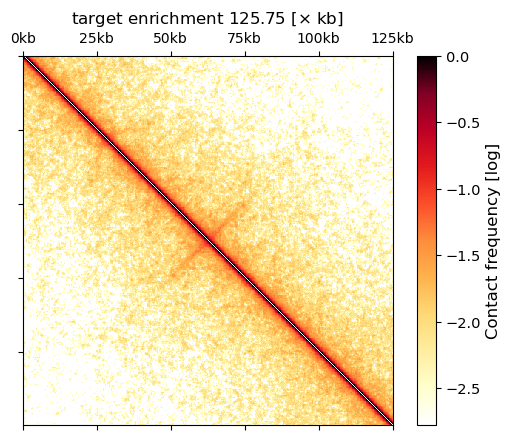

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.1_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


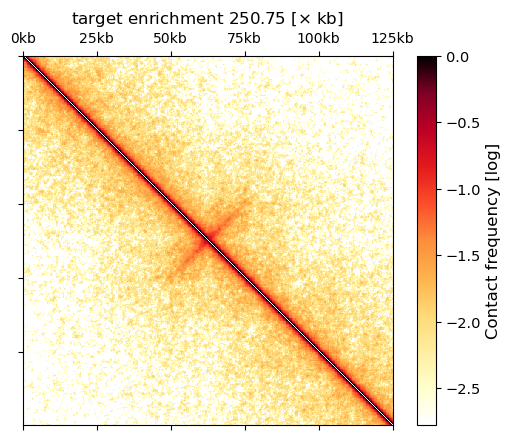

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.1_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


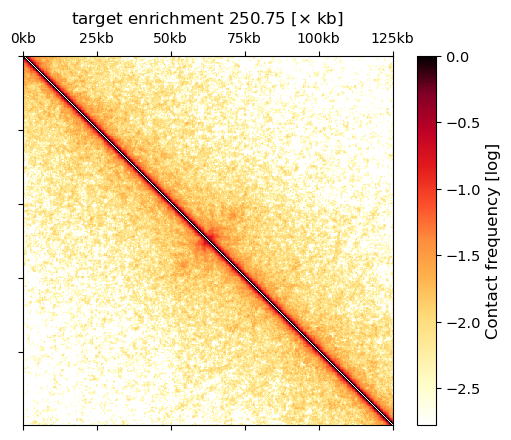

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.1_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


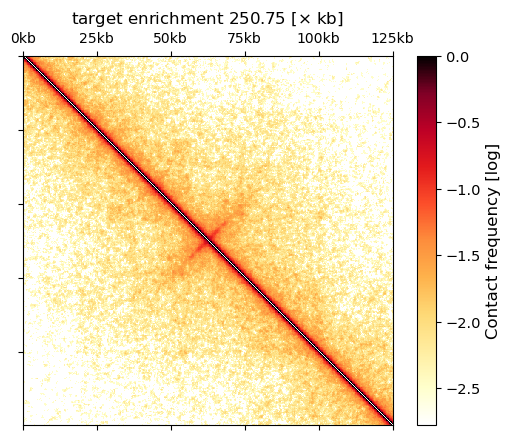

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


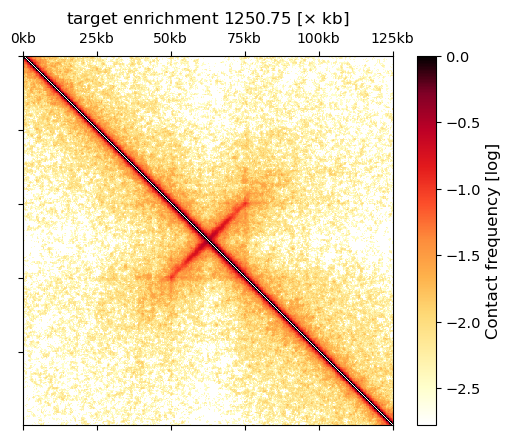

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


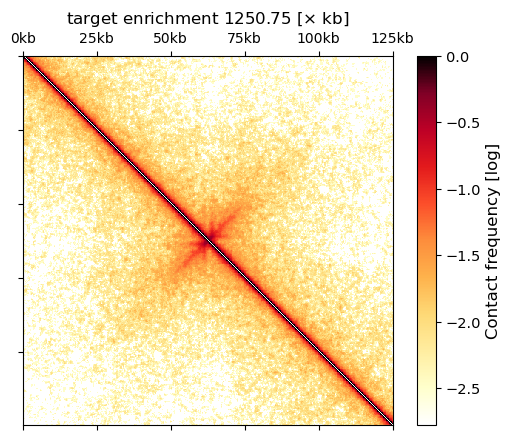

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


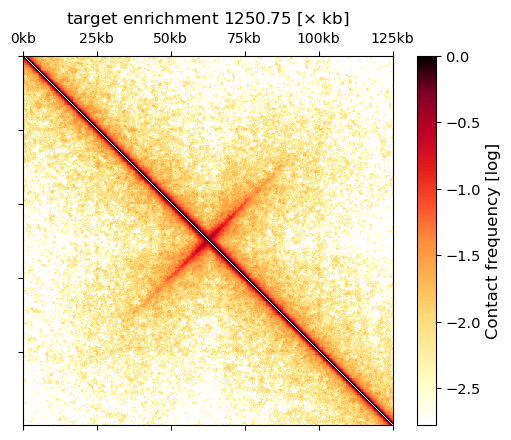

In [58]:
for name in list(path_dict)[100:]:

    #i+=1
    params=[ast.literal_eval(i) for i in name.split('folder_')[1].split('_')[1::2]]
    face, back, clife, cof, life, slife, birth, deltactcf, pause, sep, site, mon, rep, step, vel = params
    if life ==66 and sep==74:
        print(name)
        data=np.load('./maps/%s.npz' % name)
        mrc=data['arr_0']
        mrc  = mrc.astype(float)
        mrc /= np.median(np.diag(mrc,2))
        mat = np.log10(mrc)
        vmax = np.median(np.diag(mat,2))
        vmin = vmax - 3
        im=plt.matshow(mat[250:750,250:750], cmap='fall',fignum=False);
        cbar=plt.colorbar(im,label='Contact frequency [log]')
        cbar.set_label(label='Contact frequency [log]',fontsize=11.95)
        cbar.ax.tick_params(labelsize=10.5)
        plt.xticks([0,100,200,300, 400, 500], fontsize = 10.1)
        #plt.yticks([0,100,200,300,400,500],fontsize=8.1)
        plt.title('relative load prob %s'%500)
        plt.gca().set_xticklabels(['0kb', '25kb', '50kb','75kb','100kb', '125kb'])
        #plt.gca().set_yticklabels(['0Mb', '0.25Mb', '0.5Mb','0.75Mb','1Mb', '1.25Mb'])#plt.gca().set_yticklabels([])
        plt.gca().set_yticklabels([])
        plt.title(r'target enrichment %s [$\times$ kb]'%(per_k_multiplier(birth/0.0001)))
        plt.savefig('./newfigs/pdfs/maps_for_%s.pdf'%name,transparent=True)
        plt.show()   

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0001_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in log10
  from ipykernel import kernelapp as app
/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in log10


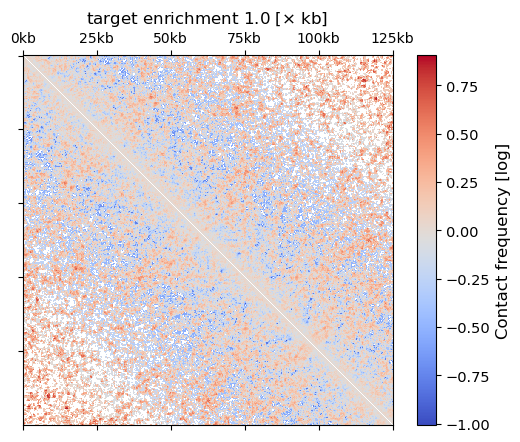

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0001_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


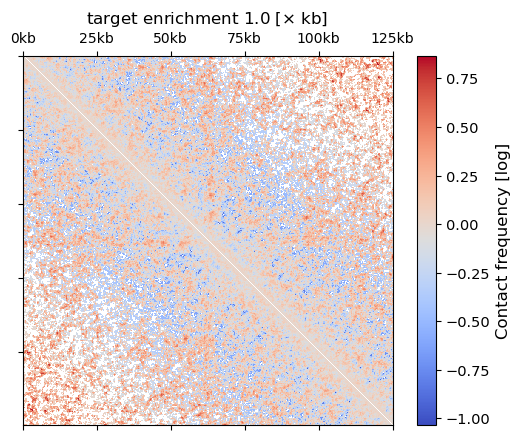

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0001_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


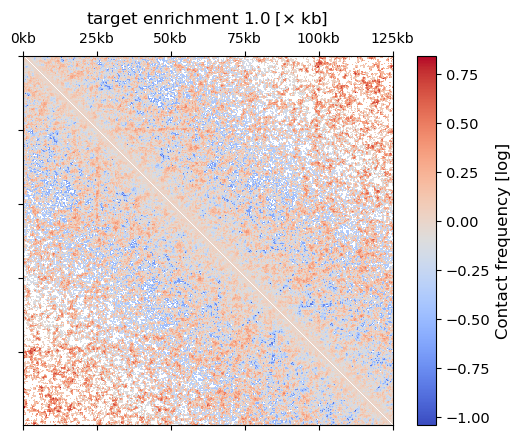

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0005_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


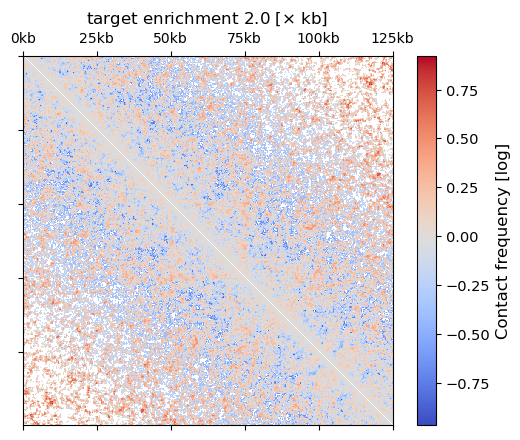

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0005_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


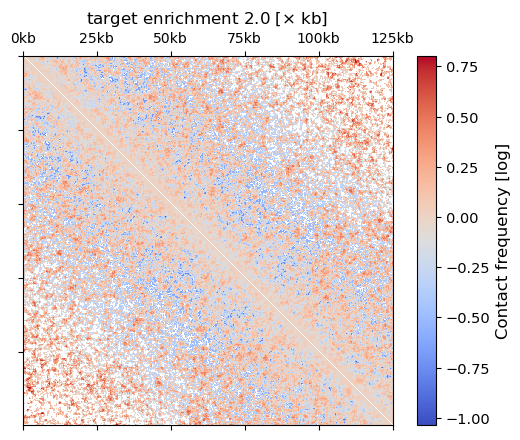

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0005_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


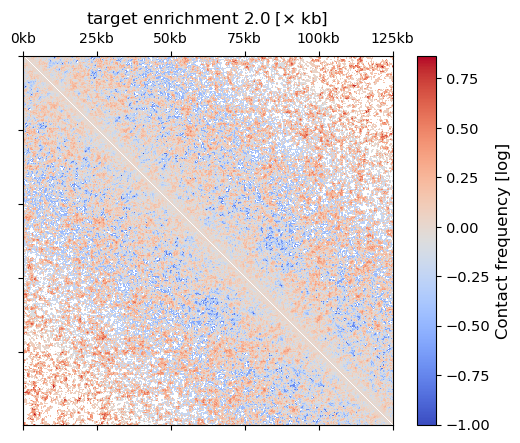

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.001_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


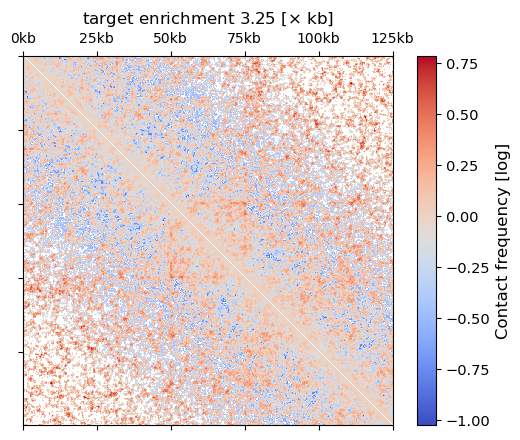

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.001_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


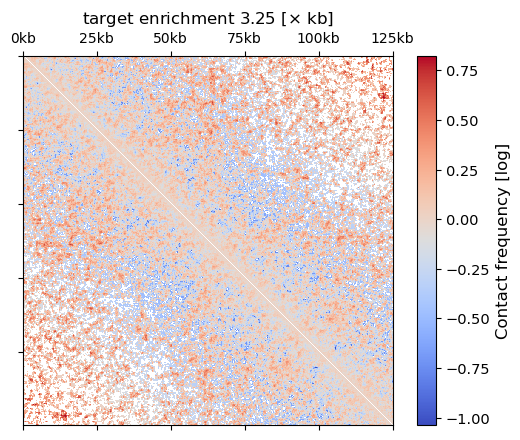

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.001_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


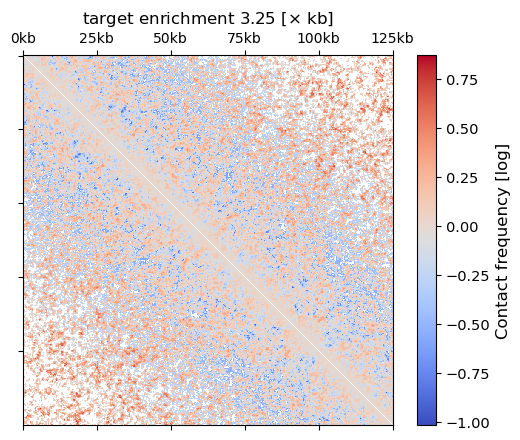

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.005_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


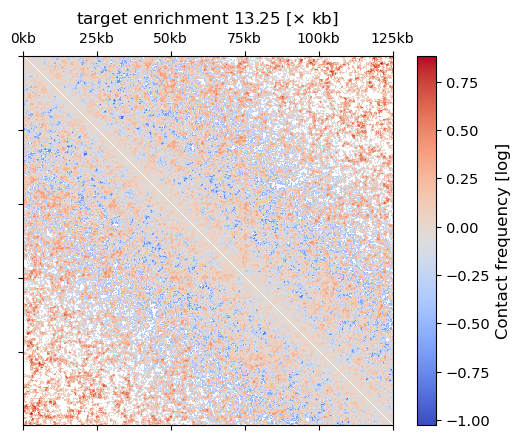

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.005_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


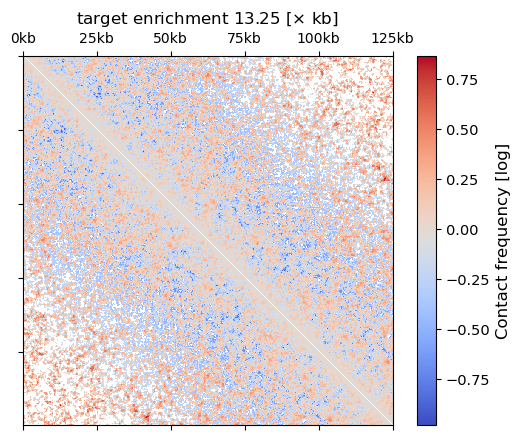

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.005_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


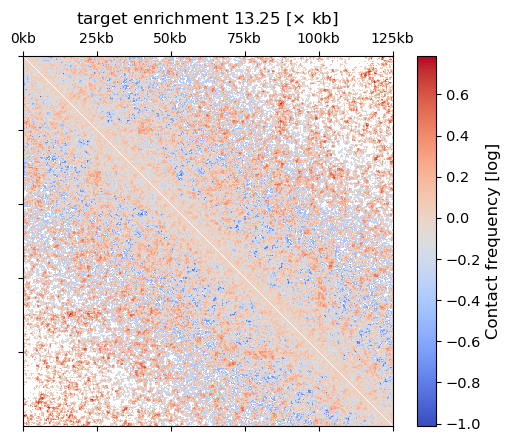

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.01_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


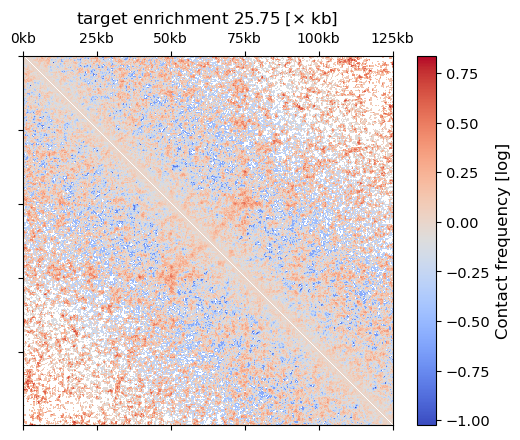

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.01_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


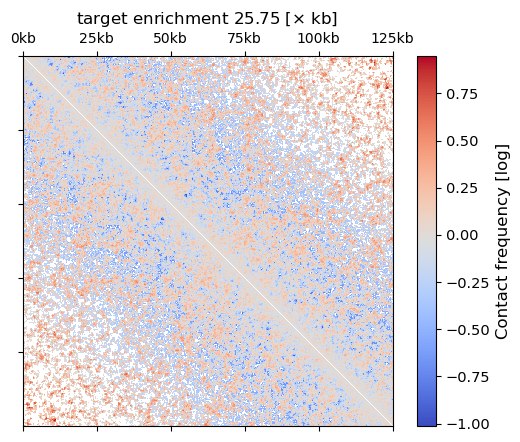

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.01_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


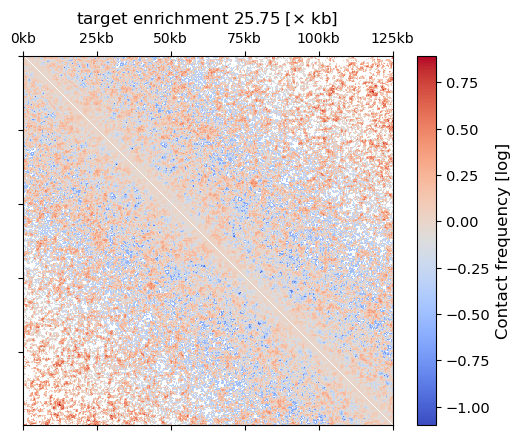

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.05_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


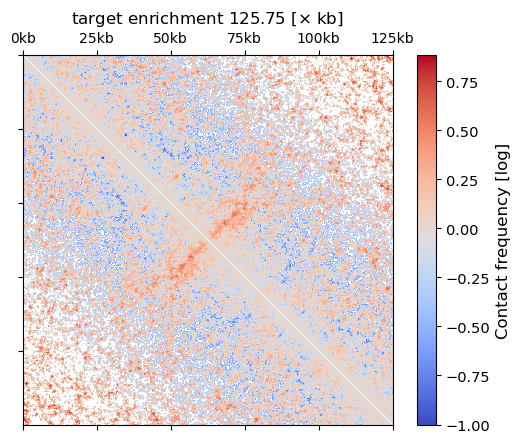

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.05_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


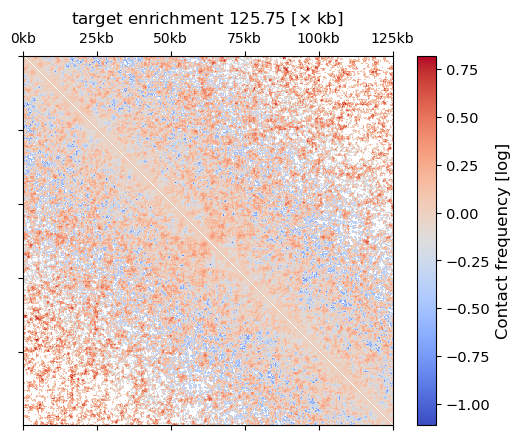

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.05_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


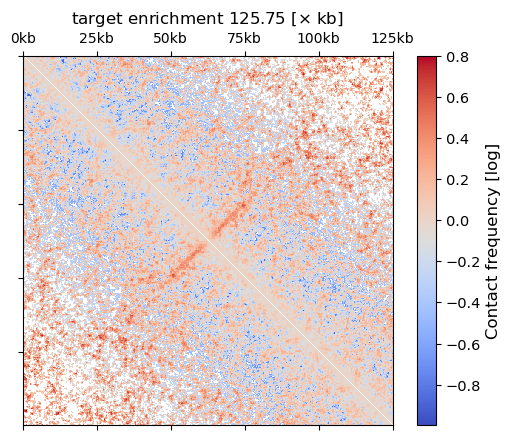

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.1_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


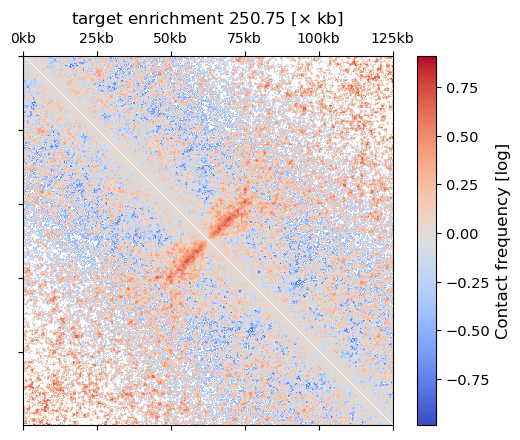

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.1_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


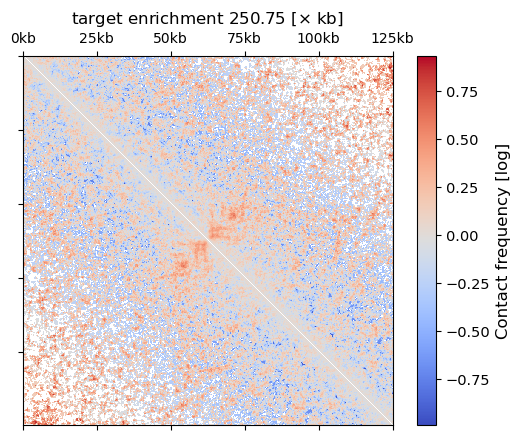

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.1_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


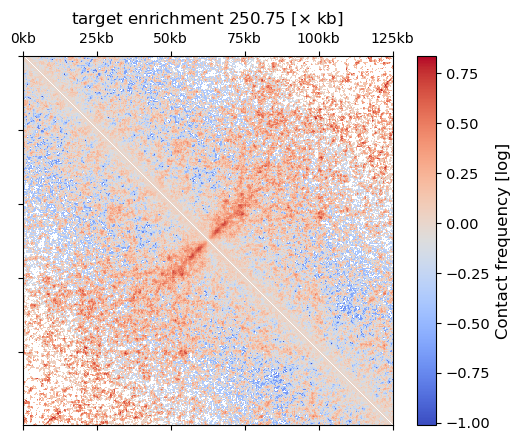

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


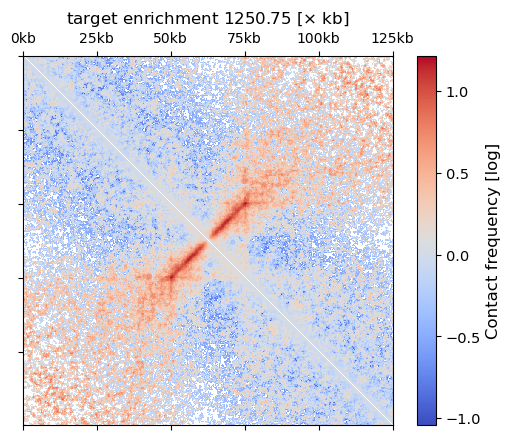

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


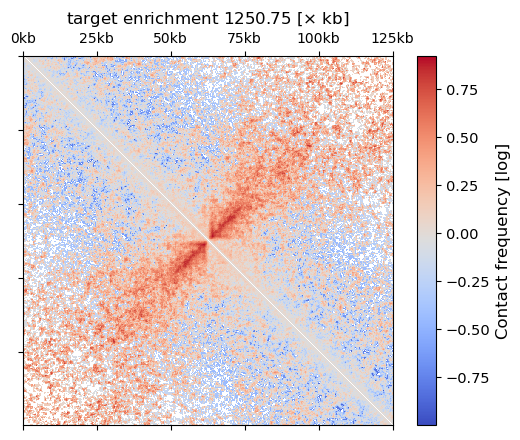

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1


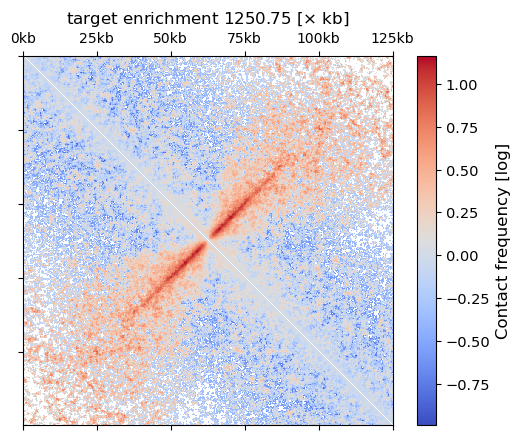

In [60]:
import chromoscores.maputils as chrmap
import chromoscores.snipping as chrsnip
import chromoscores.scorefunctions as chrscores
for name in list(path_dict)[100:]:
    params=[ast.literal_eval(i) for i in name.split('folder_')[1].split('_')[1::2]]
    face, back, clife, cof, life, slife, birth, deltactcf, pause, sep, site, mon, rep, step, vel = params
    if life ==66 and sep==74:
        print(name)
        data=np.load('./maps/%s.npz' % name)
        mrc=data['arr_0']
        mrc  = mrc.astype(float)
        mrc /= np.median(np.diag(mrc,2))
        mat = np.log10(mrc)
        vmax = np.median(np.diag(mat,2))
        vmin = vmax - 3
        mat=chrmap.get_observed_over_expected(mrc)
        im=plt.matshow(np.log10(mat[250:750,250:750]), cmap='coolwarm',fignum=False);
        cbar=plt.colorbar(im,label='Contact frequency [log]')
        cbar.set_label(label='Contact frequency [log]',fontsize=11.95)
        cbar.ax.tick_params(labelsize=10.5)
        plt.xticks([0,100,200,300, 400, 500], fontsize = 10.1)
        plt.title('relative load prob %s'%500)
        plt.gca().set_xticklabels(['0kb', '25kb', '50kb','75kb','100kb', '125kb'])
        plt.gca().set_yticklabels([])
        plt.title(r'target enrichment %s [$\times$ kb]'%(per_k_multiplier(birth/0.0001)))
        plt.show()   

### calculating fountain score

In [64]:
import chromoscores.maputils as chrmap
import chromoscores.snipping as chrsnip
import chromoscores.scorefunctions as chrscores
from scipy.stats import pearsonr
def create_matrix(n, higher_value, lower_value):
    # Create an n x n matrix filled with the lower value
    matrix = np.full((n, n), lower_value)
    
    # Assign the higher value to the anti-diagonal (diagonal of the transpose)
    for i in range(n):
        matrix[i, n - i - 1] = higher_value
    
    return matrix

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0001_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.06991858780524371


/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in log10
  if sys.path[0] == "":


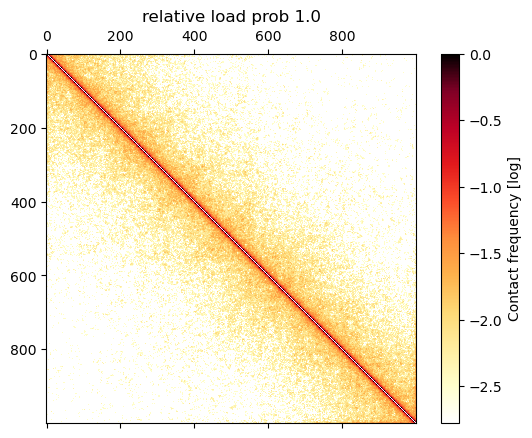

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0001_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.03913683390208334


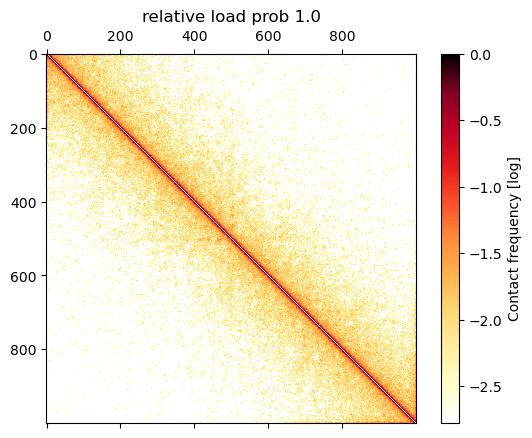

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0001_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.06430484137308733


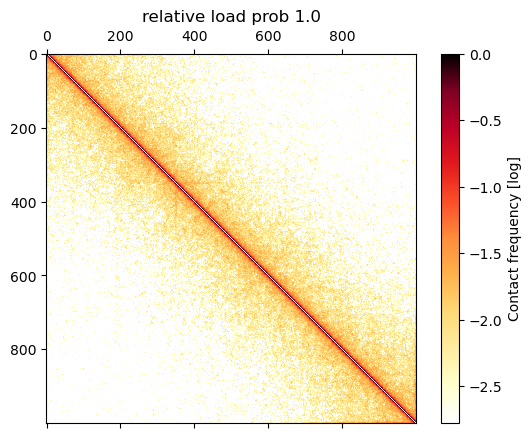

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0005_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.021365239965875464


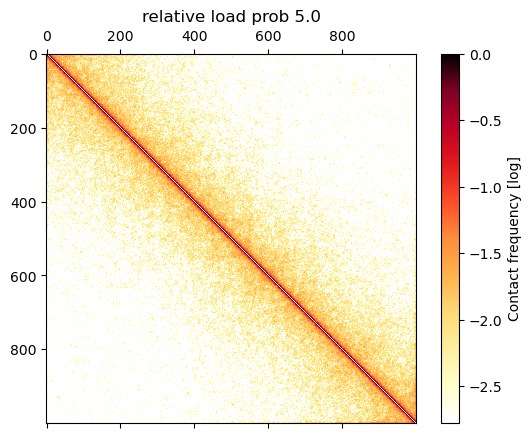

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0005_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.01882125042190248


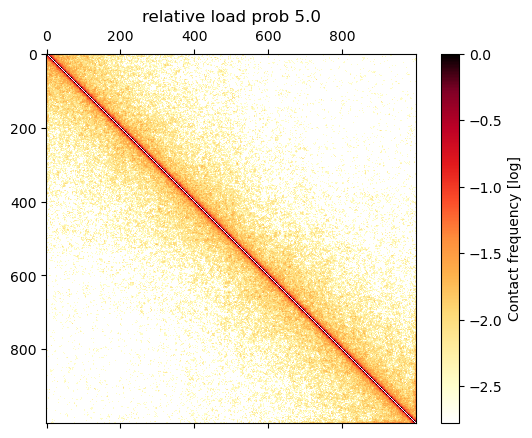

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.0005_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.03307199230513996


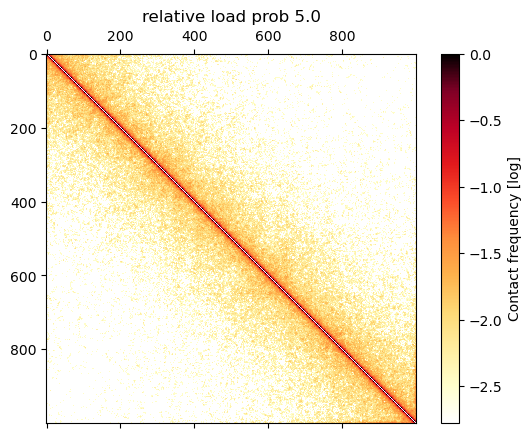

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.001_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.09664670974392943


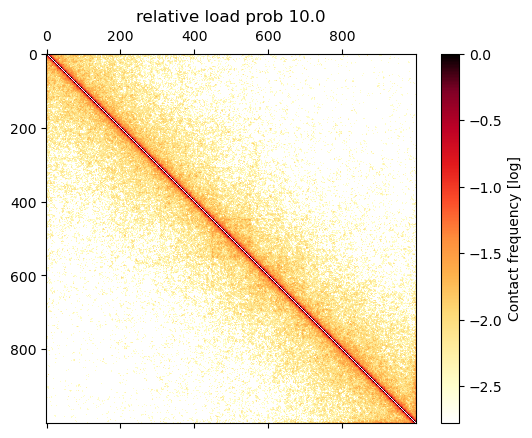

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.001_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.04154733247519304


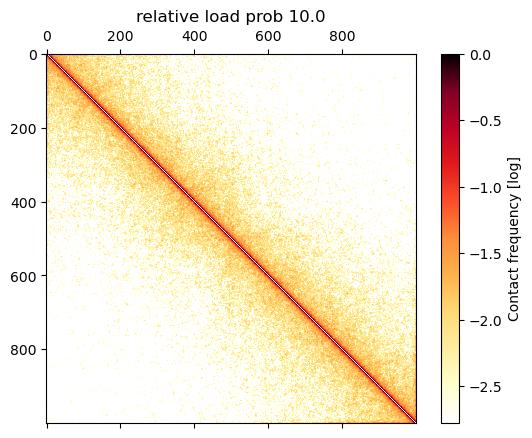

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.001_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.08759824363159367


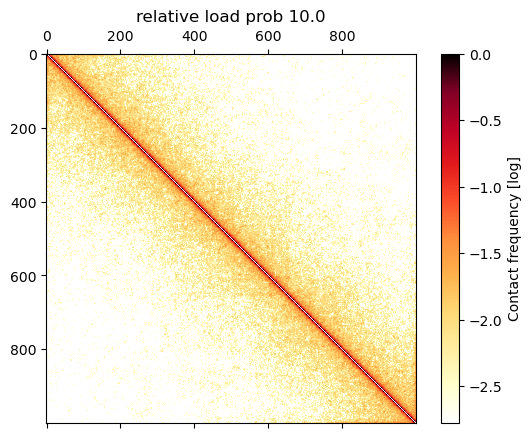

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.005_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.07618821585920792


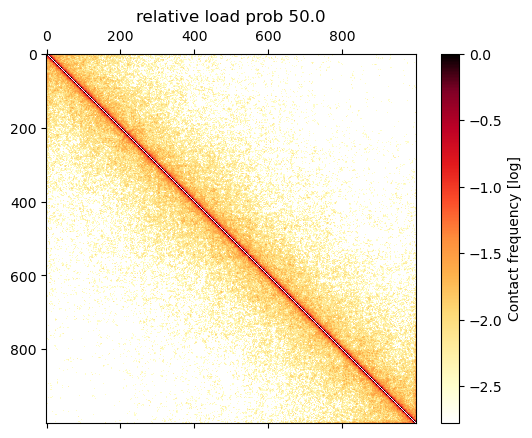

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.005_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.03926953049757311


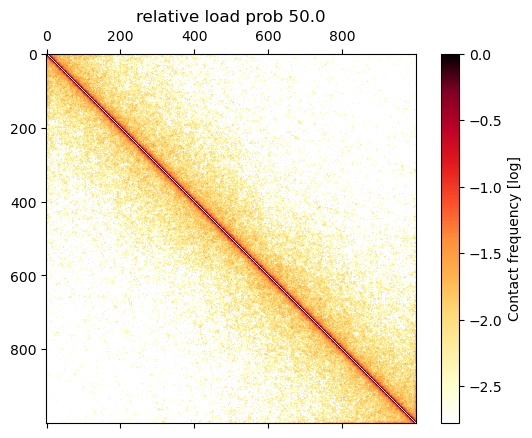

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.005_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.06756108977530419


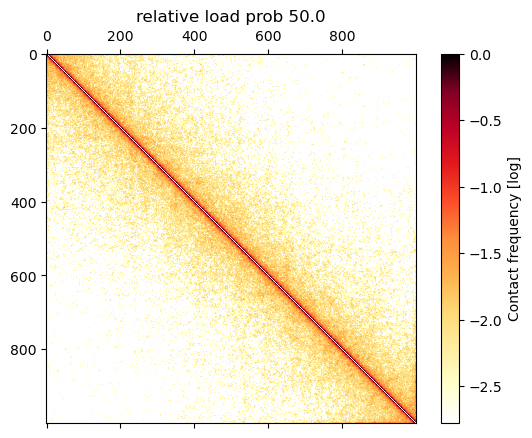

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.01_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.1333079485348698


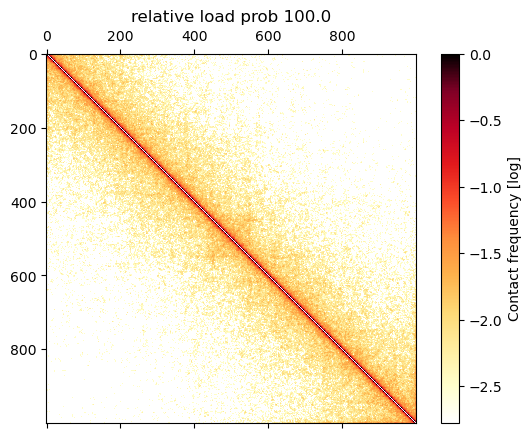

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.01_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.07270767277587634


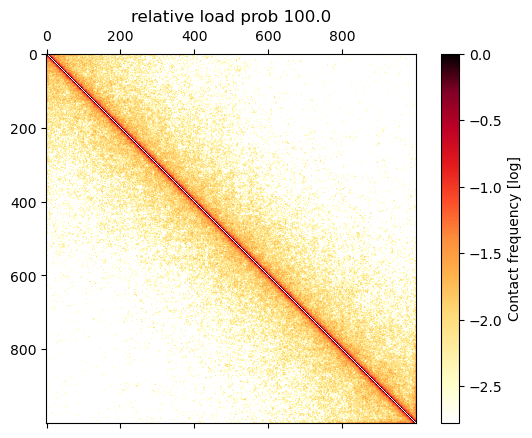

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.01_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.044847348437929396


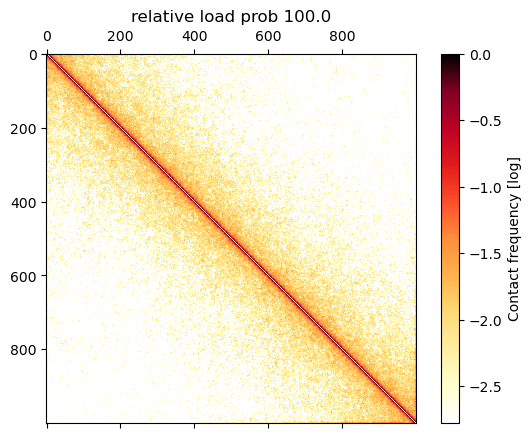

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.05_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.1719415229568036


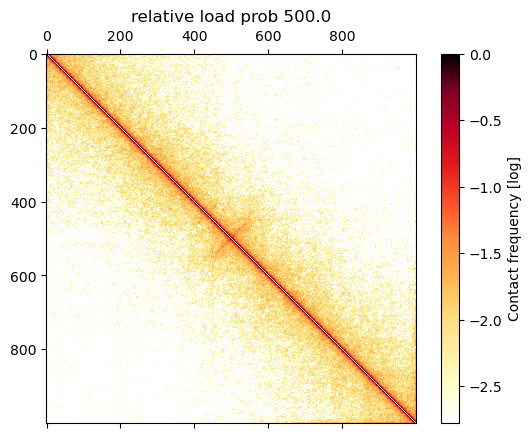

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.05_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.0767644082388337


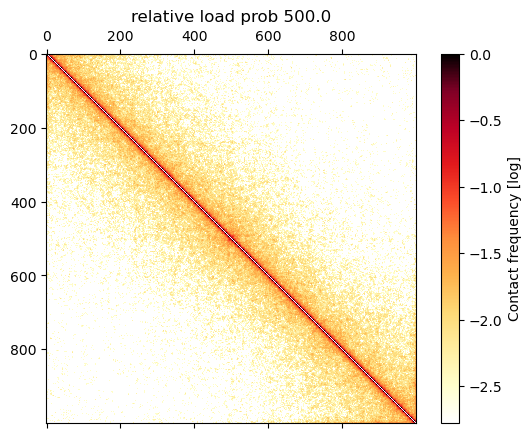

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.05_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.18440149586733412


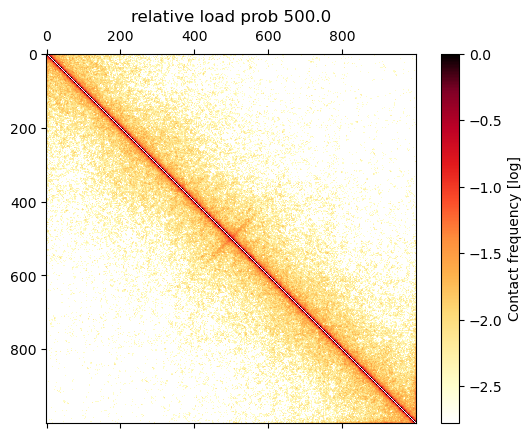

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.1_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.19341364710999828


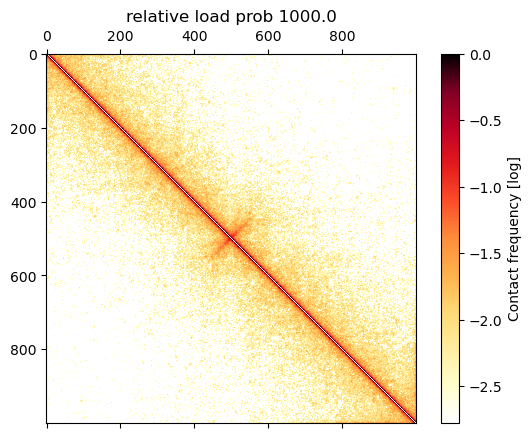

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.1_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.11015336907254367


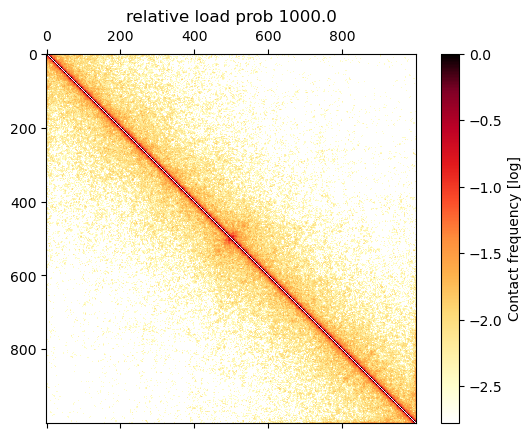

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.1_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.18979241983679881


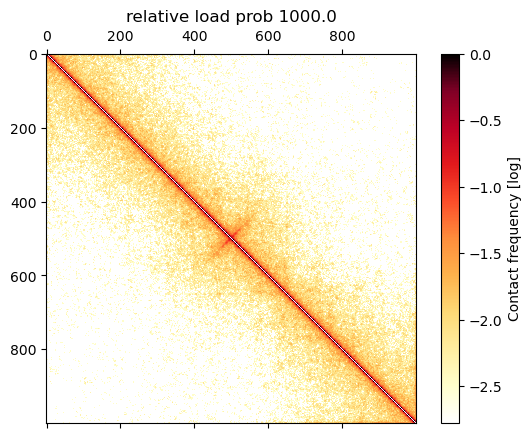

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_1000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.24762641356501042


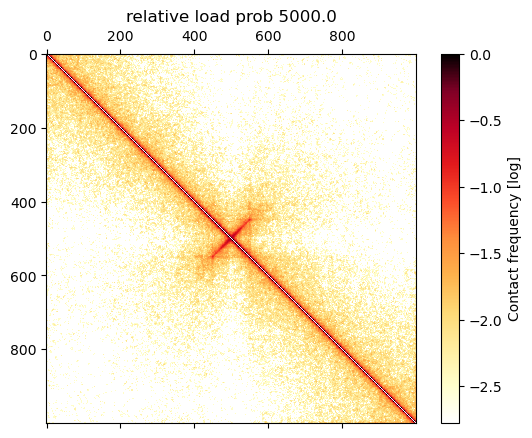

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_100_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.1742481708634408


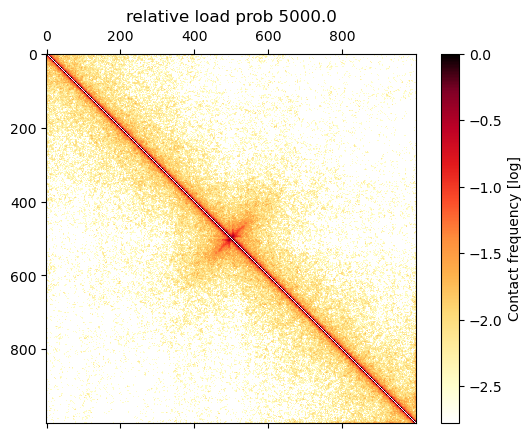

folder_face_1.0_back_0_Clife_17.0_Cof_17.0_life_66_slife_66_birth_0.5_deltactcf_3000_pause_0_sep_74_site_10_monomer_1000_replica_1_steps_200_vel_1
Pearson correlation is: 0.23933112735584333


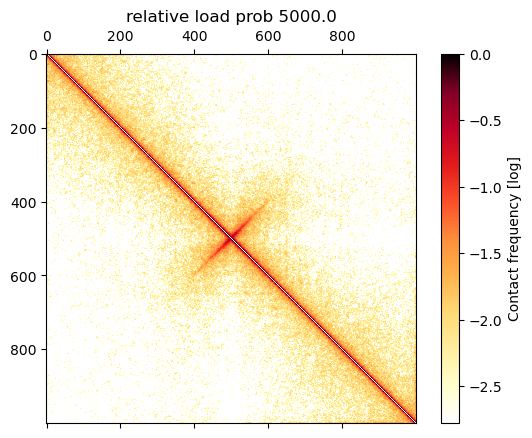

In [65]:
file = open('data/fountainttt.csv','w')
file.write('data/birth,life,sep,deltactcf,clife,cof,fountainscore\n')
for name in list(path_dict)[100:190]:
    params=[ast.literal_eval(i) for i in name.split('folder_')[1].split('_')[1::2]]
    face, back, clife, cof, life, slife, birth, deltactcf, pause, sep, site, mon, rep, step, vel = params
    if life ==66 and sep==74:
        print(name)
        data=np.load('./maps/%s.npz' % name)
        mrc=data['arr_0']
        mrc  = mrc.astype(float)
        mrc /= np.median(np.diag(mrc,2))
        mat = np.log10(mrc)

        sample_mat = mat[450:550,450:550]
        sample_mat_mean = np.nanmean(sample_mat[np.isfinite(sample_mat)])
        
        matrix = create_matrix(100, np.nanmax(sample_mat), sample_mat_mean)
        
        sample_mat_fixed = np.where(np.isinf(sample_mat), sample_mat_mean, sample_mat)
        #has_nan_or_inf = np.any(np.isinf(sample_mat_fixed))

        A = sample_mat_fixed
        B = matrix
        A = A[:len(A)//2,-len(A)//2:]
        B = B[:len(B)//2,-len(B)//2:]
        # Flatten both matrices
        A_flat = A.flatten()
        B_flat = B.flatten()
        
        A = A[:len(A)//2,-len(A)//2:]
        B = B[:len(B)//2,-len(B)//2:]
        # Calculate Pearson correlation between the two flattened matrices
        corr, _ = pearsonr(A_flat, B_flat)
        print(f"Pearson correlation is: {corr}")
        im=plt.matshow(mat[:,:], cmap='fall',fignum=False);
        cbar=plt.colorbar(im,label='Contact frequency [log]')
        plt.title('relative load prob %s'%(birth/0.0001))
        
        file.write('%s,%s,%s,%s,%s,%s,%s\n'%(birth,life,sep,deltactcf,clife,cof,corr))
        
        plt.show()   
file.close()

/home1/rahmanin/.conda/envs/openmm-env/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log10
  """


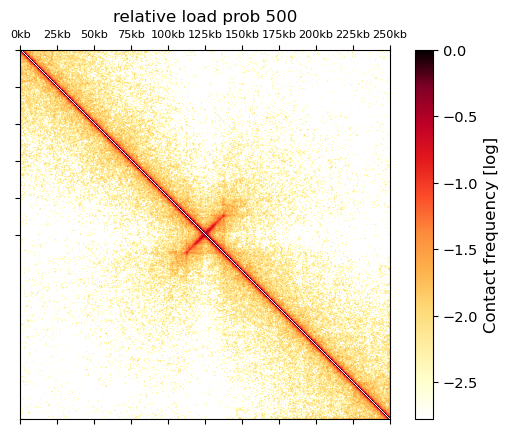

In [40]:
data=np.load('./maps/%s.npz' % name)
mrc=data['arr_0']
mrc  = mrc.astype(float)
mrc /= np.median(np.diag(mrc,2))
mat = np.log10(mrc)
vmax = np.median(np.diag(mat,2))
vmin = vmax - 3
im=plt.matshow(mat[:,:], cmap='fall',fignum=False);
cbar=plt.colorbar(im,label='Contact frequency [log]')
cbar.set_label(label='Contact frequency [log]',fontsize=11.95)
cbar.ax.tick_params(labelsize=10.5)
#cbar.set_label(r'$\zeta\ [s^{-1}]$', fontsize=16)
plt.xticks([0,100,200,300,400,500, 600, 700, 800, 900, 1000],fontsize=8.1)
plt.yticks([0,100,200,300,400,500],fontsize=8.1)
plt.title('relative load prob %s'%500)
plt.gca().set_xticklabels(['0kb', '25kb', '50kb','75kb','100kb', '125kb', '150kb', '175kb', '200kb', '225kb', '250kb'])
#plt.gca().set_yticklabels(['0Mb', '0.25Mb', '0.5Mb','0.75Mb','1Mb', '1.25Mb'])#plt.gca().set_yticklabels([])
plt.gca().set_yticklabels([])
plt.show()

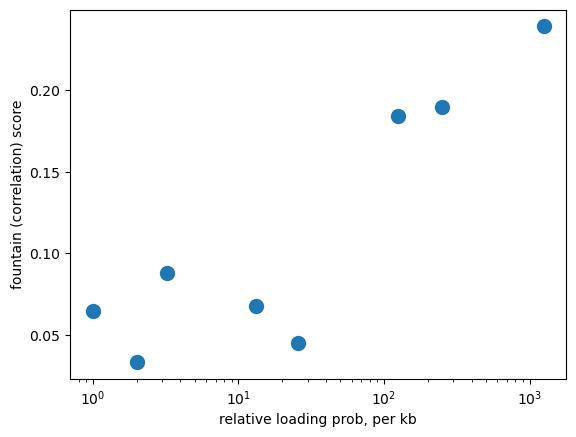

In [46]:
file = pd.read_csv('fountain.csv')
file
file['birthp']=per_k_multiplier(file['birth']/0.0001)
new_file = file[file['deltactcf']==3000]
plt.scatter(new_file['birthp'],new_file['fountainscore'], s=100)
plt.ylabel('fountain (correlation) score')
plt.xlabel('relative loading prob, per kb')
plt.xscale('log')
plt.savefig('fountainscore.png')
plt.show()